In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv("csv_files/pid.csv")

In [ ]:
df.head(1)

,stop_from,stop_from_name,stop_to,stop_to_name,depart_from,arrive_to,route_type,is_night,monday,tuesday,wednesday,thursday,friday,saturday,sunday
0,U2991Z301,Hněvice,T58005,Hněvice seř.n.,4:53:00,4:54:30,2,0,1,1,1,1,1,0,0


In [ ]:
for column in df.columns:
    print( f"{column} has {len(df[column].unique())} unique values")

stop_from has 15178 unique values
stop_from_name has 7389 unique values
stop_to has 15154 unique values
stop_to_name has 7387 unique values
depart_from has 14021 unique values
arrive_to has 13858 unique values
route_type has 6 unique values
is_night has 2 unique values
monday has 2 unique values
tuesday has 2 unique values
wednesday has 2 unique values
thursday has 2 unique values
friday has 2 unique values
saturday has 2 unique values
sunday has 2 unique values


First of all I want to convert time in datetime form, also I want to solve problem, that some time has more than 23 hour, which isn't possible.

I'll add new column to our dataframe, which will contain info about extra day. It will have True value, when time more than 23 hours.

In [ ]:
from numpy import datetime64

df["extra_day_depart"] = False
df["extra_day_arrive"] = False
for idx, rows in df.iterrows():
    if(int(rows["depart_from"].split(":")[0]) > 23):
        df.at[idx, "extra_day_depart"] = True
    res = str(int(rows["depart_from"].split(":")[0])%24) + ":" + \
                            rows["depart_from"].split(":")[1]     + ":" + \
                            rows["depart_from"].split(":")[2]
    df.at[idx, "depart_from"] = res
    if(int(rows["arrive_to"].split(":")[0]) > 23):
        df.at[idx, "extra_day_arrive"] = True
    res = str(int(rows["arrive_to"].split(":")[0])%24) + ":" + \
                            rows["arrive_to"].split(":")[1]     + ":" + \
                            rows["arrive_to"].split(":")[2]
    df.at[idx, "arrive_to"] = res        

Now I will give some columns type, cause it helps work with dataframe faster

In [ ]:
df = df.astype({"depart_from": datetime64})
df = df.astype({"arrive_to": datetime64})

df = df.astype({"is_night": bool})
df = df.astype({"monday": bool})
df = df.astype({"tuesday": bool})
df = df.astype({"wednesday": bool})
df = df.astype({"thursday": bool})
df = df.astype({"friday": bool})
df = df.astype({"saturday": bool})
df = df.astype({"sunday": bool})


In [ ]:
df.head(5)

,stop_from,stop_from_name,stop_to,stop_to_name,depart_from,arrive_to,route_type,is_night,monday,tuesday,wednesday,thursday,friday,saturday,sunday,extra_day_depart,extra_day_arrive
0,U2991Z301,Hněvice,T58005,Hněvice seř.n.,2022-12-11 04:53:00,2022-12-11 04:54:30,2,False,True,True,True,True,True,False,False,False,False
1,T58005,Hněvice seř.n.,U4610Z301,Záluží,2022-12-11 04:54:30,2022-12-11 04:56:00,2,False,True,True,True,True,True,False,False,False,False
2,U4610Z301,Záluží,U4609Z301,Dobříň,2022-12-11 04:56:00,2022-12-11 04:59:00,2,False,True,True,True,True,True,False,False,False,False
3,U4609Z301,Dobříň,U4608Z301,Roudnice nad Labem,2022-12-11 04:59:00,2022-12-11 05:03:00,2,False,True,True,True,True,True,False,False,False,False
4,U4608Z301,Roudnice nad Labem,U4609Z301,Dobříň,2022-12-11 04:36:00,2022-12-11 04:38:00,2,False,True,True,True,True,True,False,False,False,False


This part add one day to time columns, if time had more than 23 hours

In [ ]:
import datetime
for idx, rows in df.iterrows():
    if rows.extra_day_depart == True:
        rows.depart_from = rows.depart_from + datetime.timedelta(days=1)
    if rows.extra_day_arrive == True:
        rows.arrive_to = rows.arrive_to + datetime.timedelta(days=1)

Now I want to add new column `time`, which will contain time between `stop_to_name` and `stop_from_name`.

 `Time` is counted in minutes.

In [ ]:
df["time"] = ""
for idx, rows in df.iterrows():
    diff = rows.arrive_to - rows.depart_from
    df.at[idx, "time"] = diff.total_seconds()/60

In [ ]:
df["time"].head(5)

0    1.5
1    1.5
2    3.0
3    4.0
4    2.0
Name: time, dtype: object

In [ ]:
df = df.astype({"route_type": "category"})
df = df.astype({"time": float})

Let's start vizualization part with Networkx

In [ ]:
import networkx as nx

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
graph_monday = nx.Graph()
graph_tuesday = nx.Graph()
graph_wednesday = nx.Graph()
graph_thursday = nx.Graph()
graph_friday = nx.Graph()
graph_saturday = nx.Graph()
graph_sunday = nx.Graph()

`weekday_edge` will have edges on each week day.

Structure with `nx.from_pandas_edgelist` is more faster, than adding nodes in `for` loop



In [ ]:
monday_edges = pd.DataFrame(df.loc[df.monday == True][["stop_from_name", "stop_to_name", "time"]])
tuesday_edges = pd.DataFrame(df.loc[df.tuesday == True][["stop_from_name", "stop_to_name", "time"]])
wednesday_edges = pd.DataFrame(df.loc[df.wednesday == True][["stop_from_name", "stop_to_name", "time"]])
thursday_edges = pd.DataFrame(df.loc[df.thursday == True][["stop_from_name", "stop_to_name", "time"]])
friday_edges = pd.DataFrame(df.loc[df.friday == True][["stop_from_name", "stop_to_name", "time"]])
saturday_edges = pd.DataFrame(df.loc[df.saturday == True][["stop_from_name", "stop_to_name", "time"]])
sunday_edges = pd.DataFrame(df.loc[df.sunday == True][["stop_from_name", "stop_to_name", "time"]])

In [ ]:
graph_monday = nx.from_pandas_edgelist(monday_edges, "stop_from_name", "stop_to_name", "time")
graph_tuesday = nx.from_pandas_edgelist(tuesday_edges, "stop_from_name", "stop_to_name", "time")
graph_wednesday = nx.from_pandas_edgelist(wednesday_edges, "stop_from_name", "stop_to_name", "time")
graph_thursday = nx.from_pandas_edgelist(thursday_edges, "stop_from_name", "stop_to_name", "time")
graph_friday = nx.from_pandas_edgelist(friday_edges, "stop_from_name", "stop_to_name", "time")
graph_saturday = nx.from_pandas_edgelist(saturday_edges, "stop_from_name", "stop_to_name", "time")
graph_sunday = nx.from_pandas_edgelist(sunday_edges, "stop_from_name", "stop_to_name", "time")

In [ ]:
!pip install --upgrade scipy


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


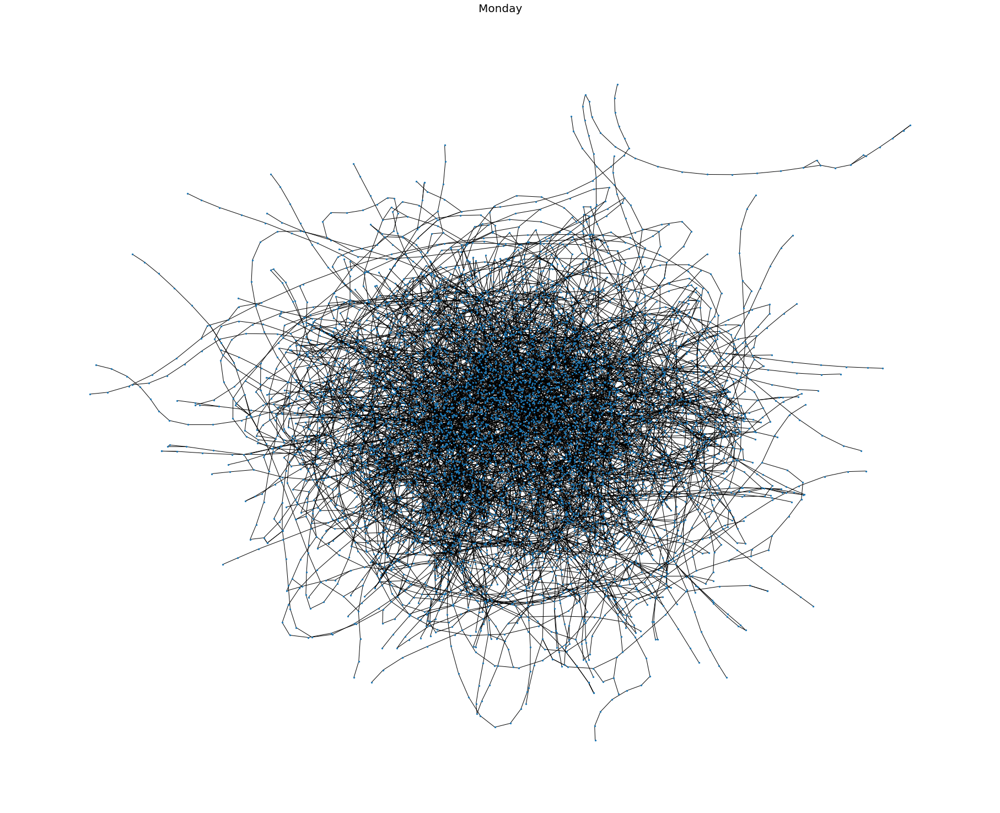

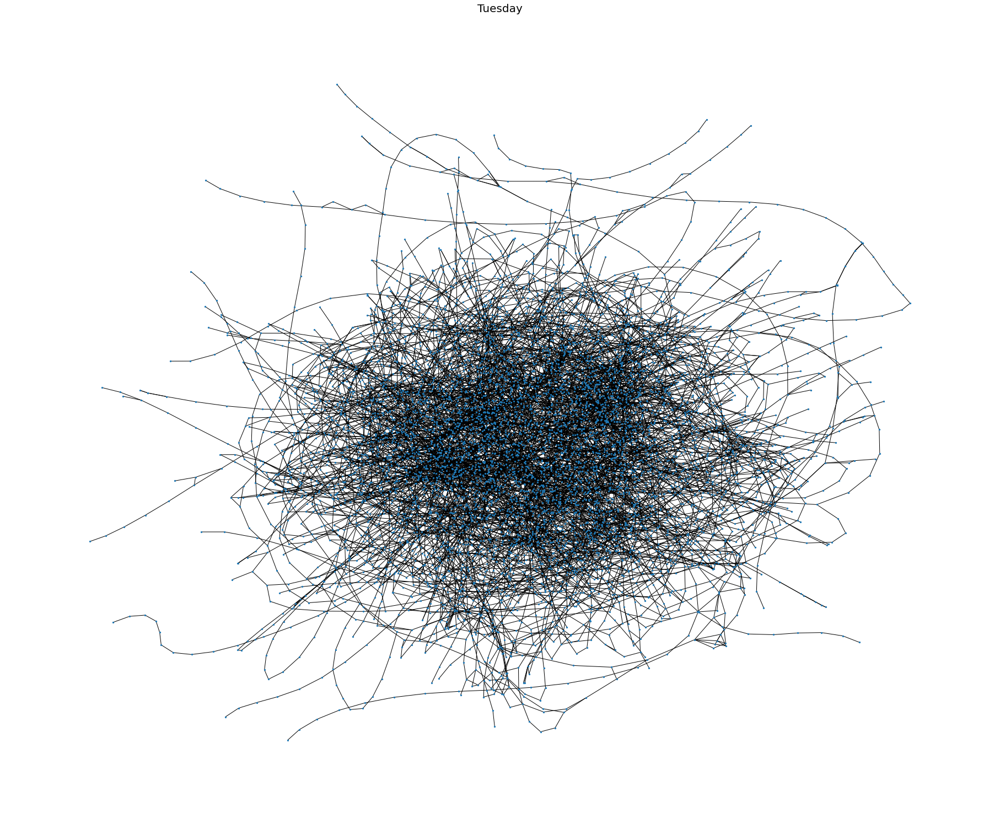

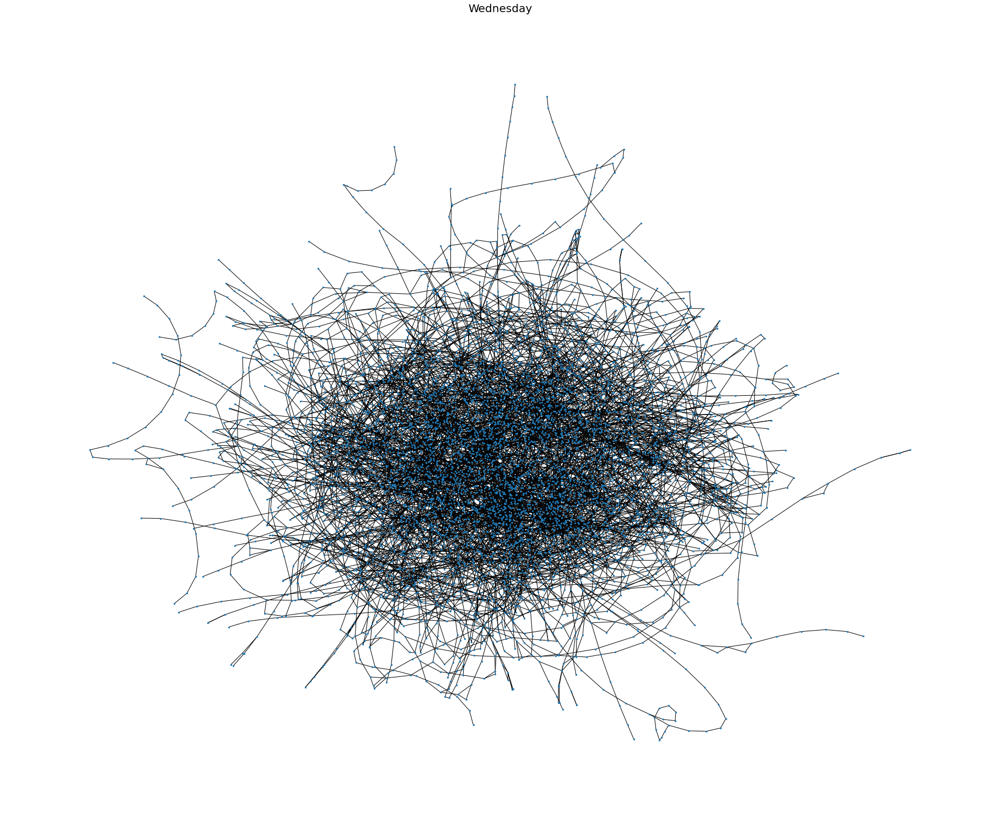

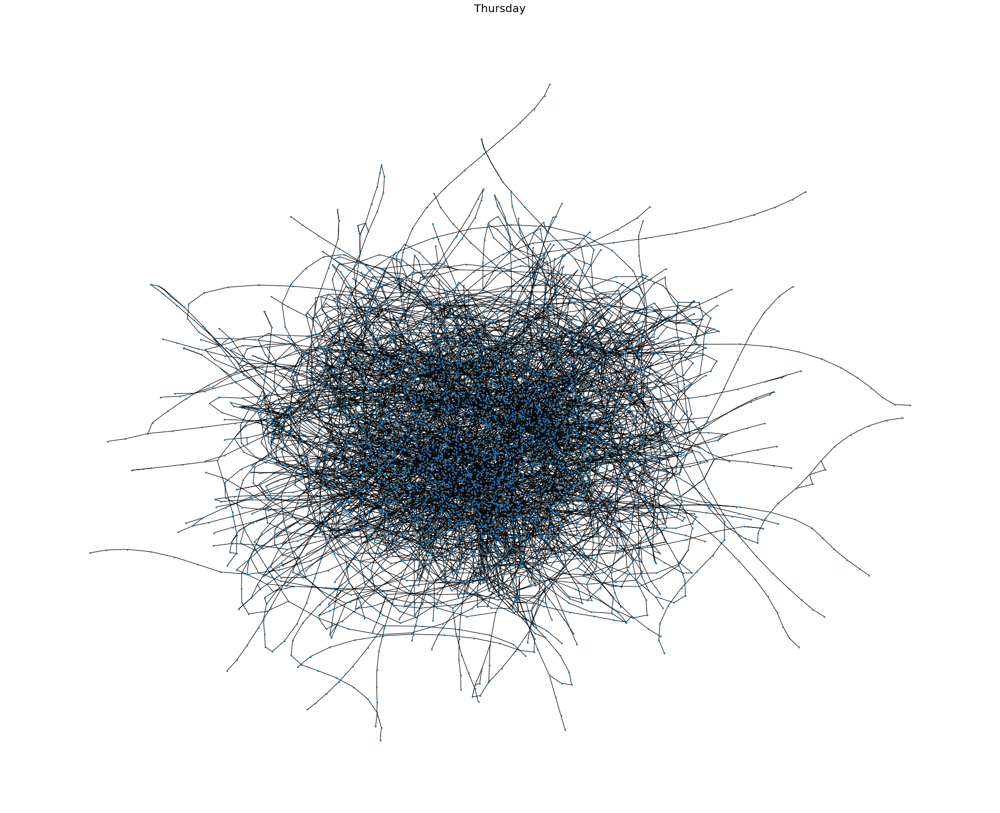

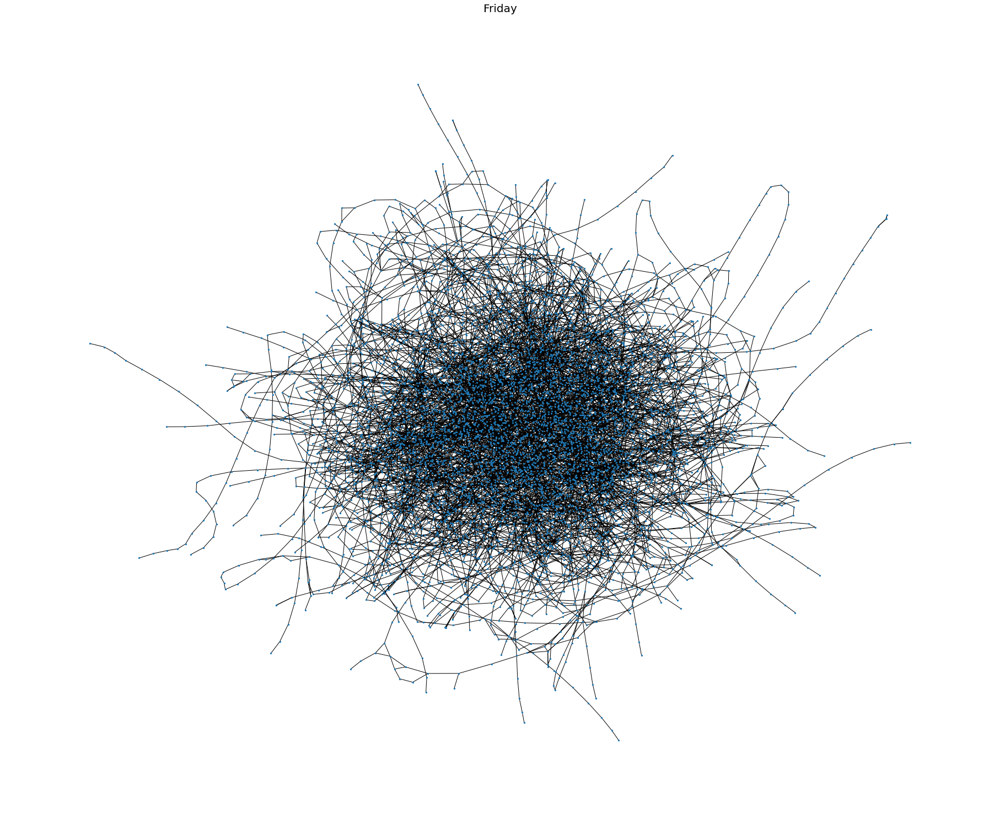

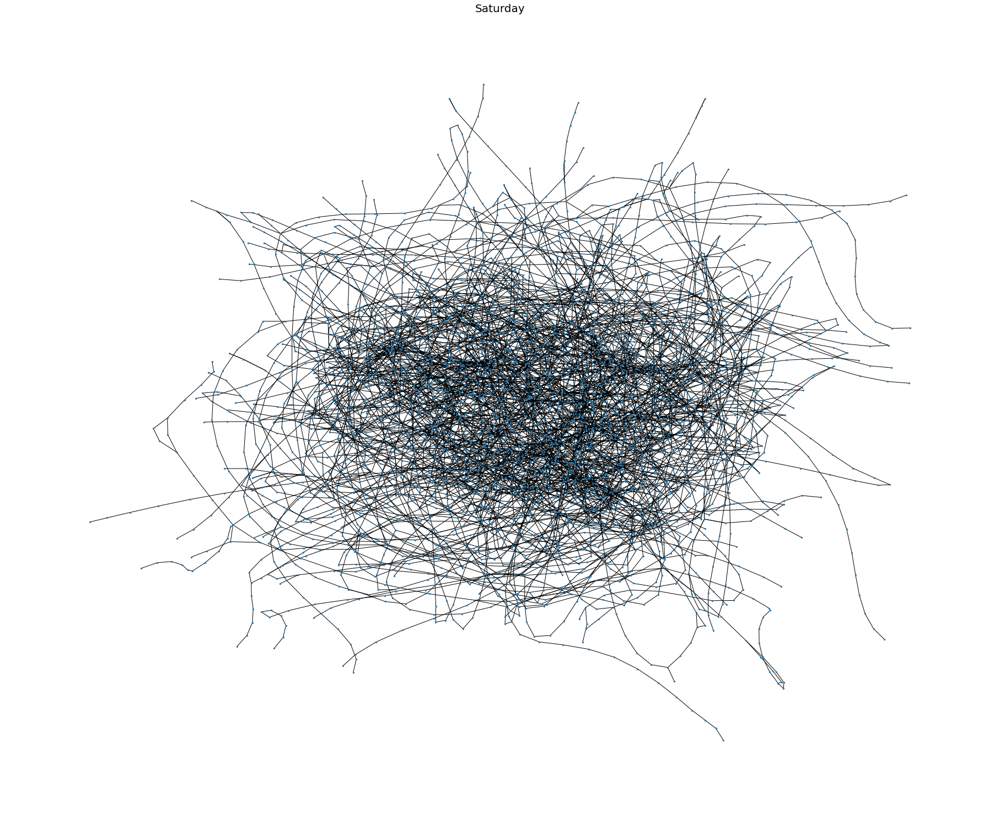

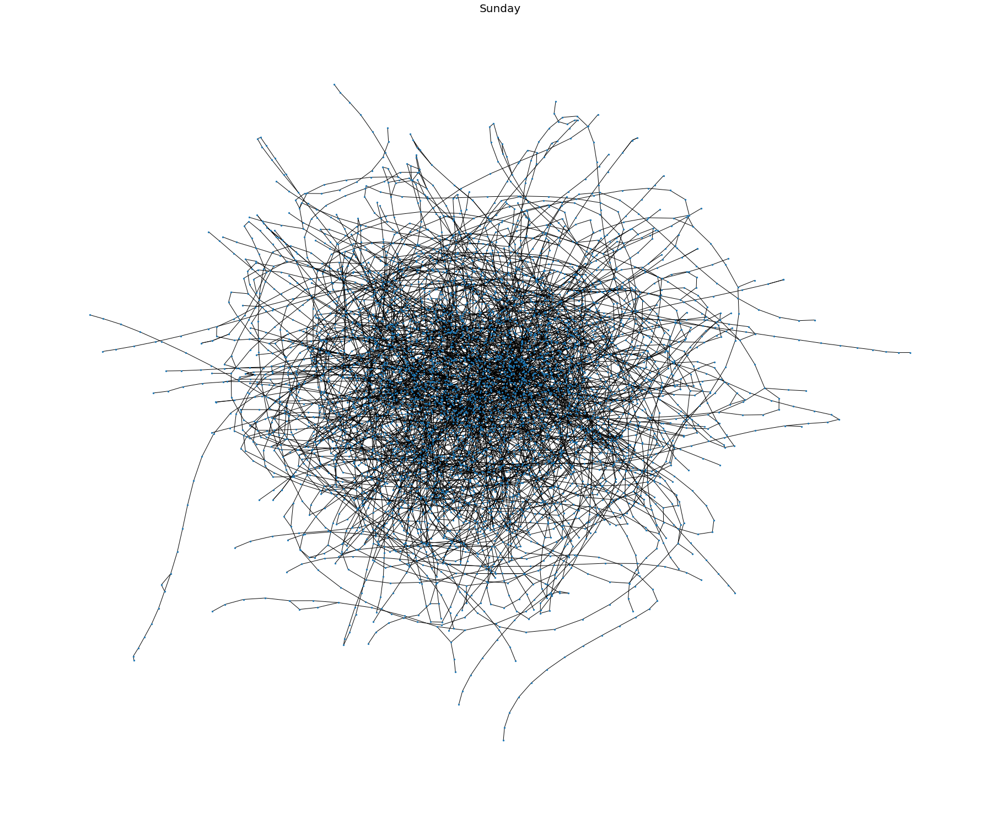

In [ ]:
plt.figure(figsize = (25,20))
nx.draw(graph_monday, node_size = 5)
plt.title("Monday", fontsize = 20)
plt.show()

plt.figure(figsize = (25,20))
nx.draw(graph_tuesday, node_size = 5)
plt.title("Tuesday", fontsize = 20)
plt.show()

plt.figure(figsize = (25,20))
nx.draw(graph_wednesday, node_size = 5)
plt.title("Wednesday", fontsize = 20)
plt.show()

plt.figure(figsize = (25,20))
nx.draw(graph_thursday , node_size = 5)
plt.title("Thursday", fontsize = 20)
plt.show()

plt.figure(figsize = (25,20))
nx.draw(graph_friday, node_size = 5)
plt.title("Friday", fontsize = 20)
plt.show()

plt.figure(figsize = (25,20))
nx.draw(graph_saturday, node_size = 5)
plt.title("Saturday", fontsize = 20)
plt.show()

plt.figure(figsize = (25,20))
nx.draw(graph_sunday, node_size = 5)
plt.title("Sunday", fontsize = 20)
plt.show()

Here's problem that we vizualise all transport, so we need to work with each route_type

In [ ]:
route_types = list(df["route_type"].unique())

In [ ]:
name_type = {
    0: "Tram",
    1: "Metro",
    2: "Rail",
    3: "Bus",
    4: "Ferry",
    5: "Cable tram",
    6: "Aerial lift",
    7: "Funicular",
    11: "Trolleybus",
    12: "Monorail"
}

In [ ]:
for route_type in route_types:
    print(name_type[route_type])

Rail
Bus
Tram
Ferry
Funicular
Metro


Let's create `dict`'s with networkX graphs, which is own for each `route_type`.

Here we will have three `dict`: for monday, for sunday and for night

In [ ]:
graph_route_type_monday = {}
for route_type in route_types:
    graph_route_type_monday[route_type] = nx.Graph()

graph_route_type_sunday = {}
for route_type in route_types:
    graph_route_type_sunday[route_type] = nx.Graph()

graph_route_type_night = {}
for route_type in route_types:
    graph_route_type_night[route_type] = nx.Graph()


Now let's vizualise different route_types on Monday, Sunday and at night

In [ ]:
for route_type in route_types:
    edges = pd.DataFrame(df.loc[(df.monday == True) & (df.route_type == route_type)][["stop_from_name", "stop_to_name", "time"]])
    graph_route_type_monday[route_type] = nx.from_pandas_edgelist(edges, "stop_from_name", "stop_to_name", "time")

for route_type in route_types:
    edges = pd.DataFrame(df.loc[(df.sunday == True) & (df.route_type == route_type)][["stop_from_name", "stop_to_name", "time"]])
    graph_route_type_sunday[route_type] = nx.from_pandas_edgelist(edges, "stop_from_name", "stop_to_name", "time")

for route_type in route_types:
    edges = pd.DataFrame(df.loc[(df.is_night == True) & (df.route_type == route_type)][["stop_from_name", "stop_to_name", "time"]])
    graph_route_type_night[route_type] = nx.from_pandas_edgelist(edges, "stop_from_name", "stop_to_name", "time")
    

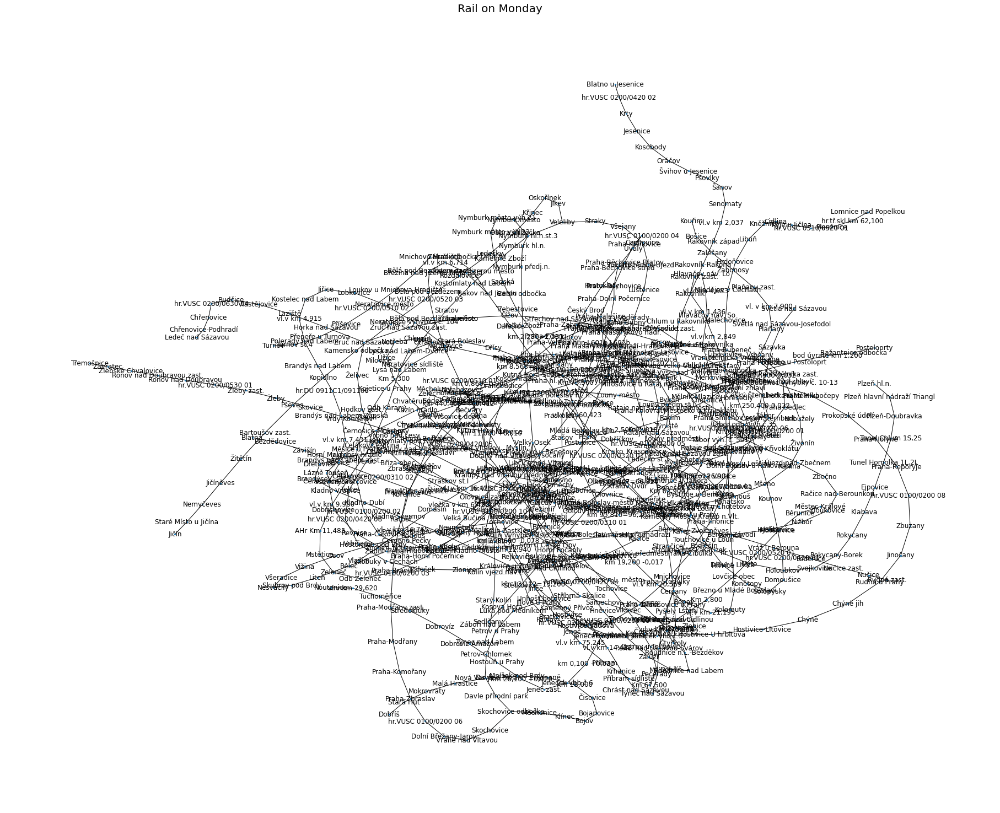

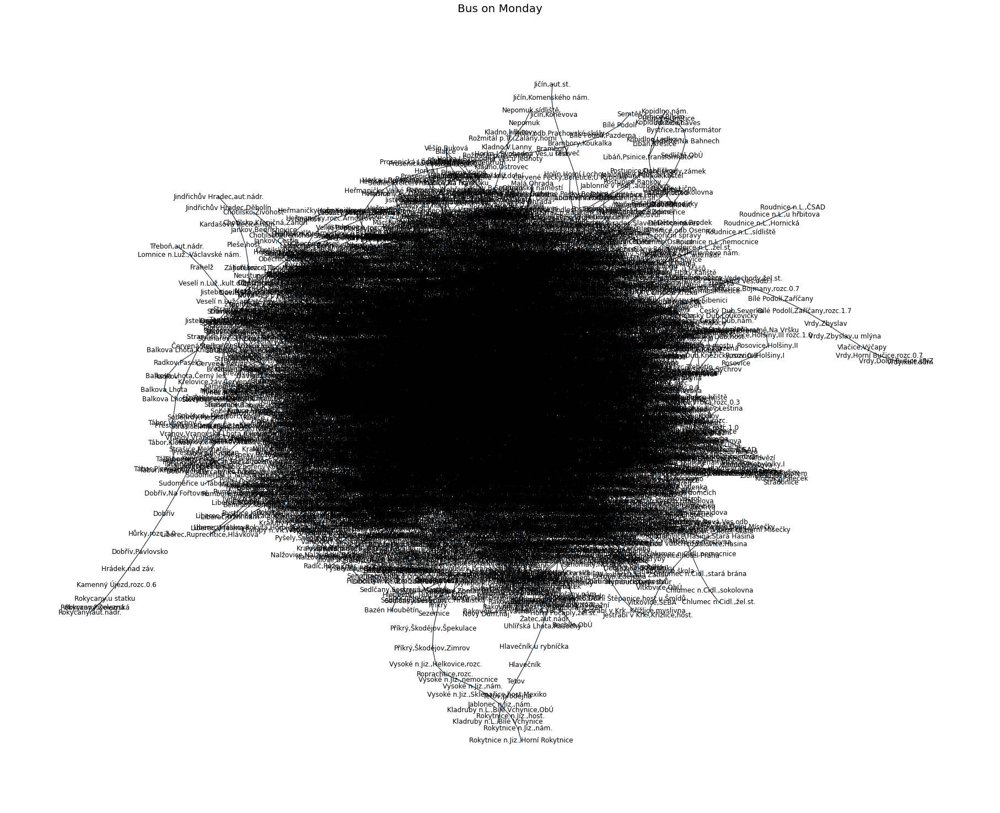

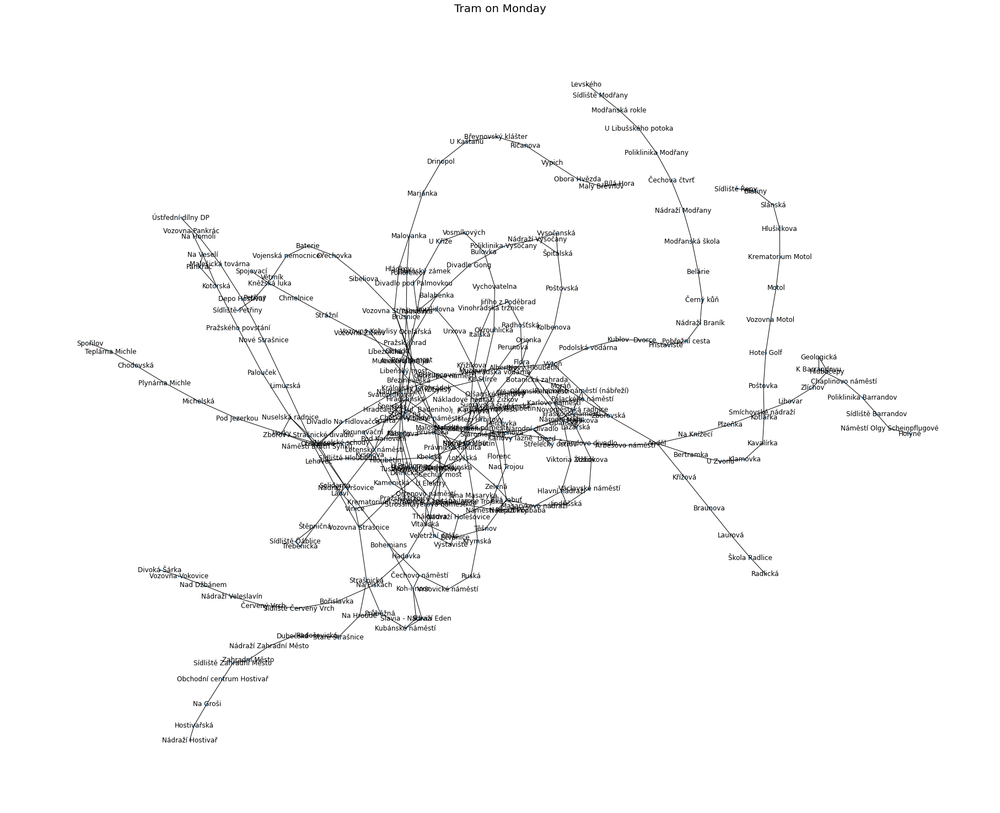

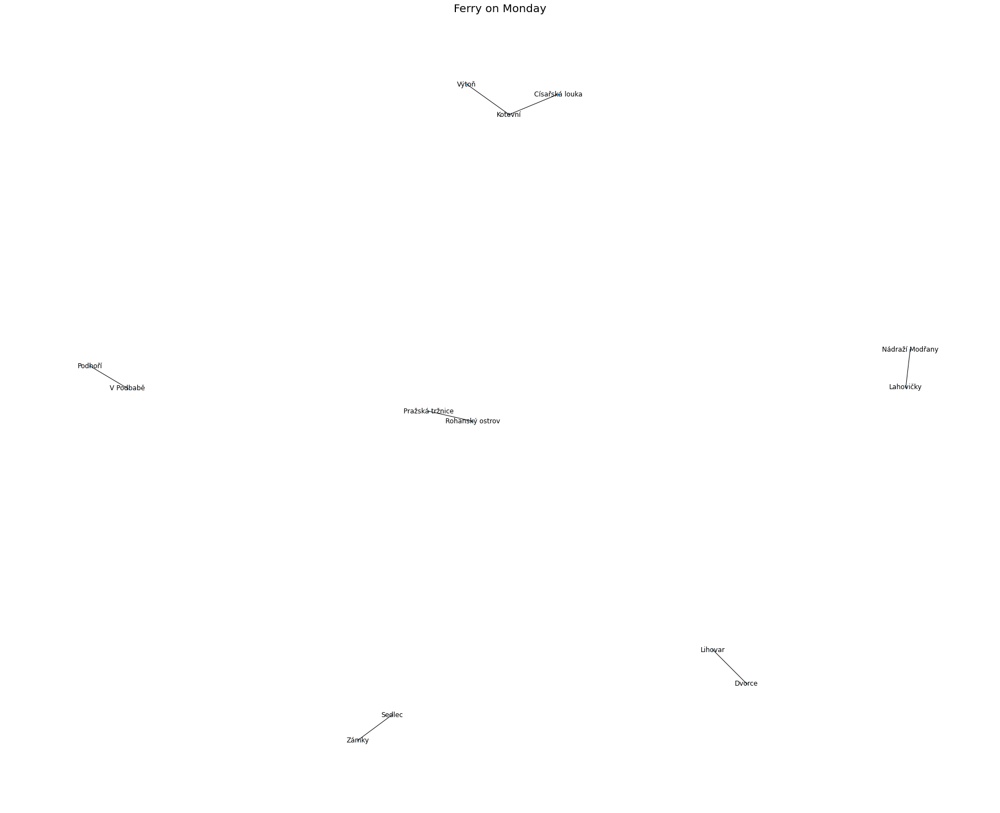

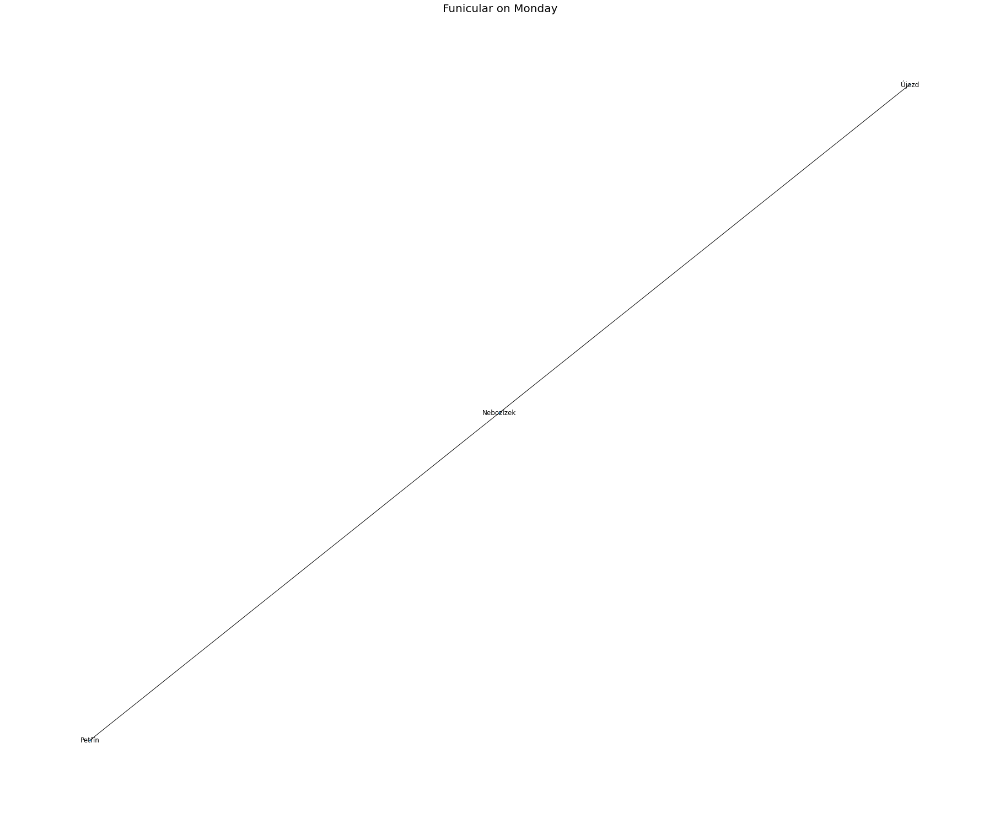

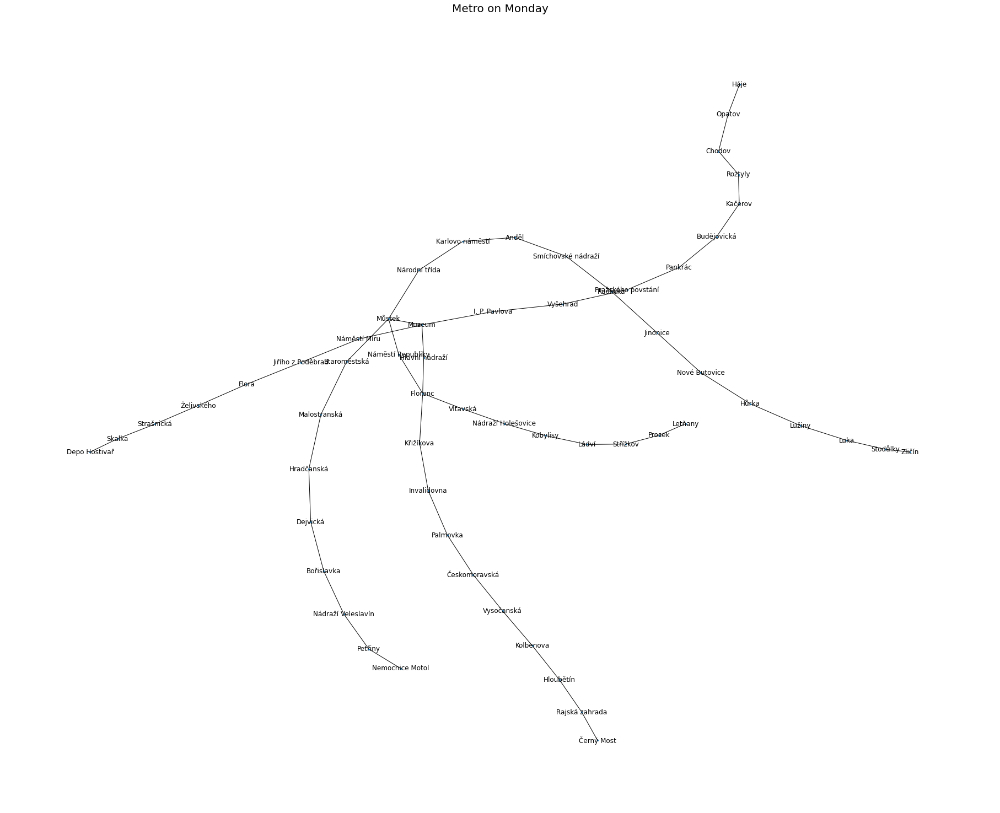

In [ ]:
for route_type in route_types:
    plt.figure(figsize = (25,20))
    nx.draw(graph_route_type_monday[route_type], node_size = 5, with_labels = True)
    plt.title(f"{name_type[route_type]} on Monday", fontsize = 20)
    plt.show()

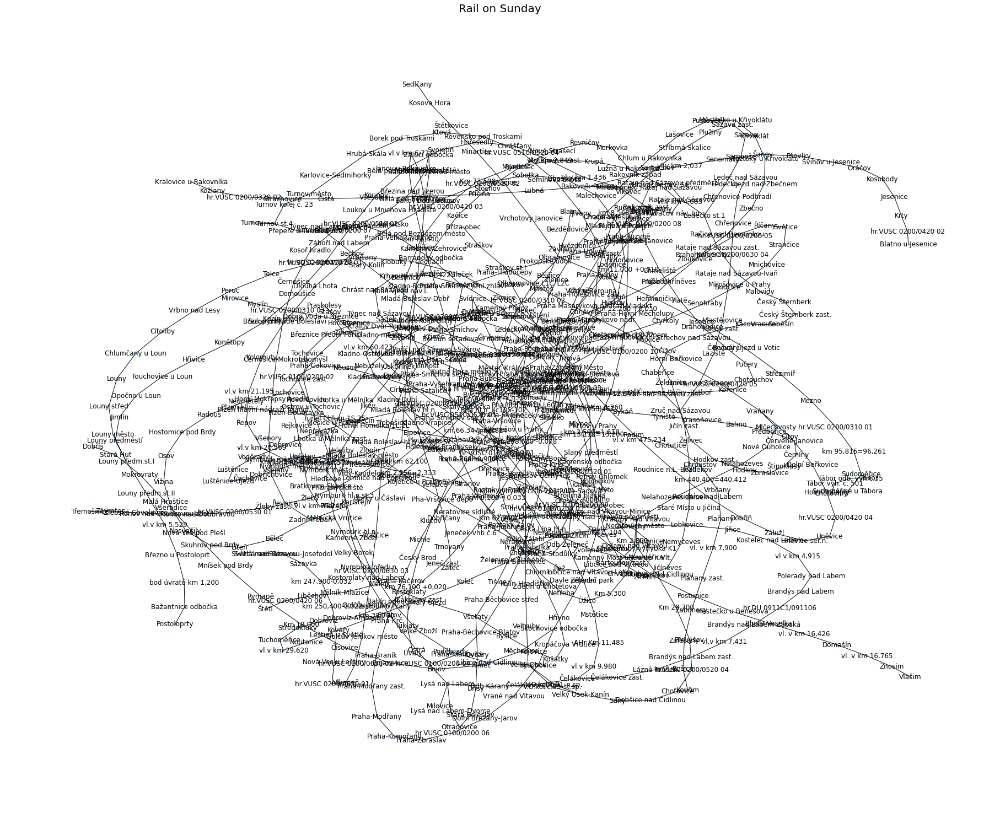

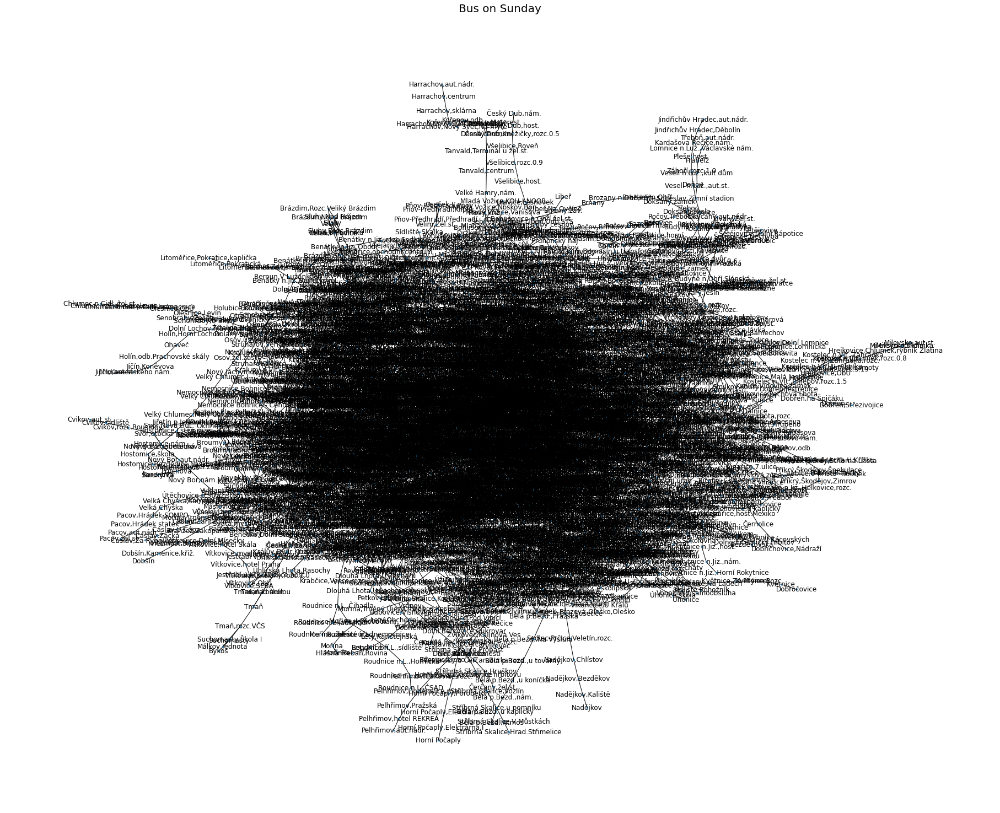

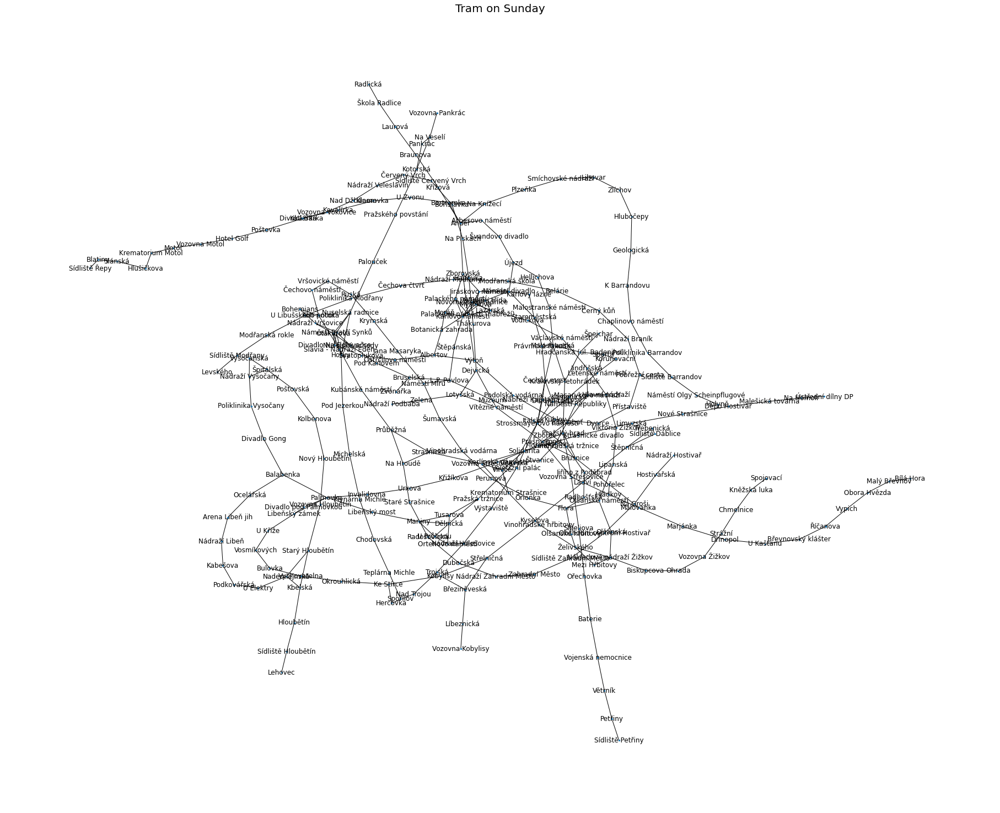

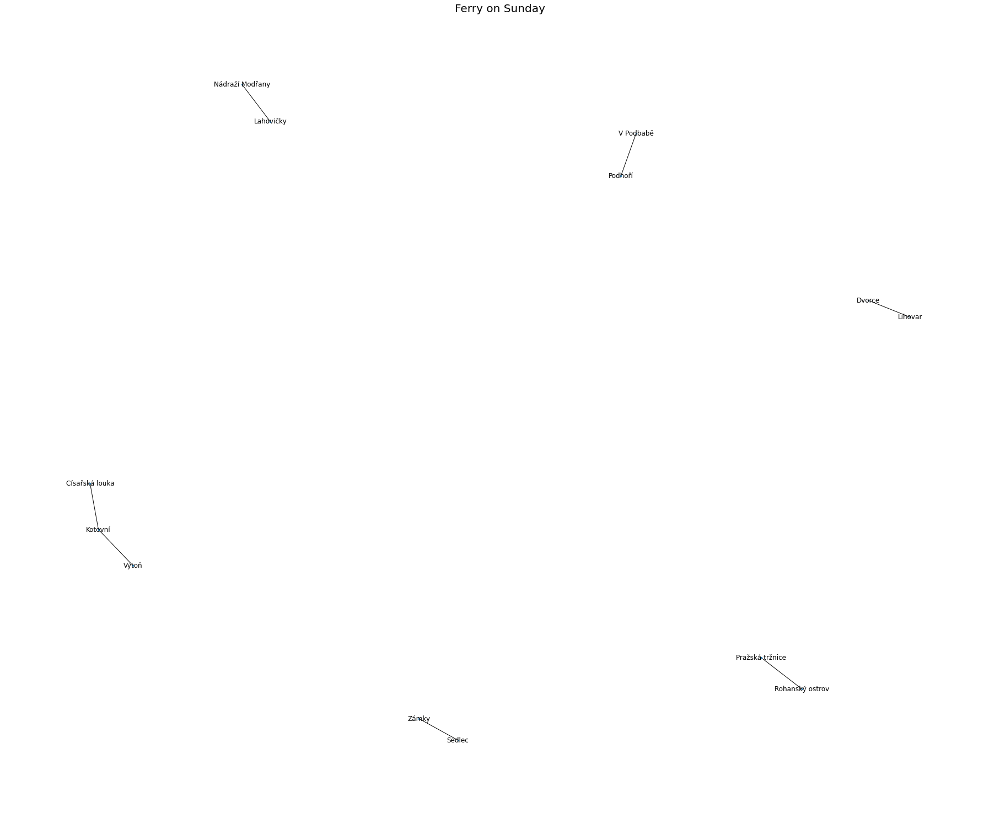

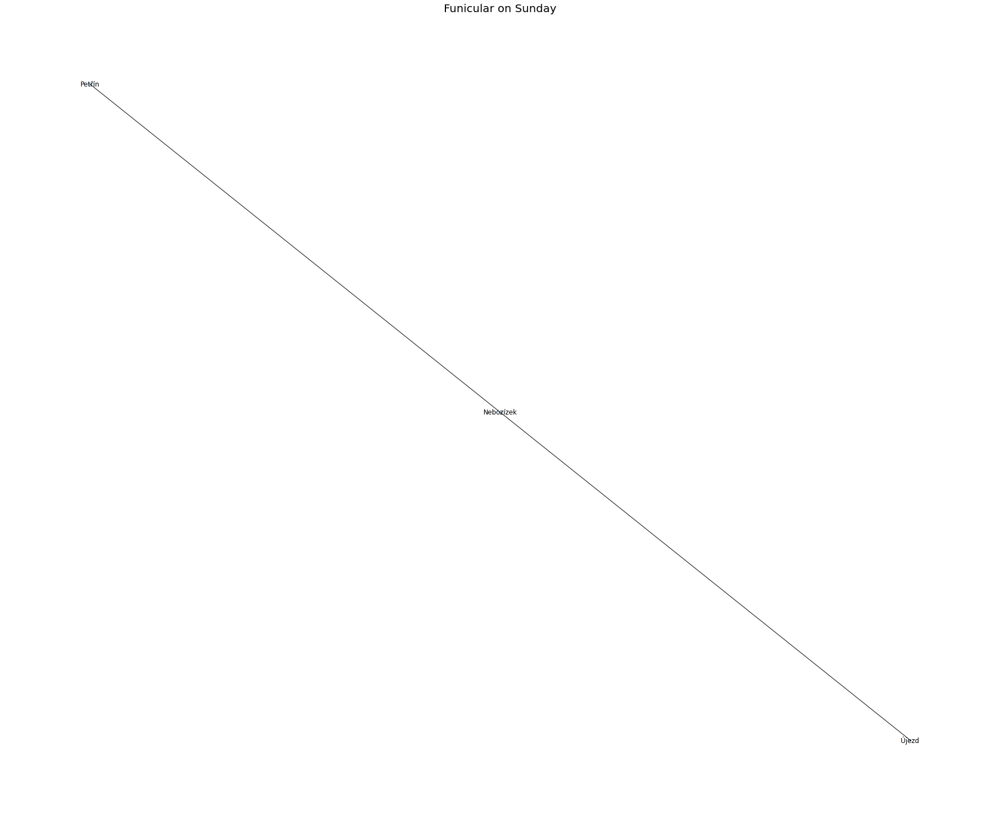

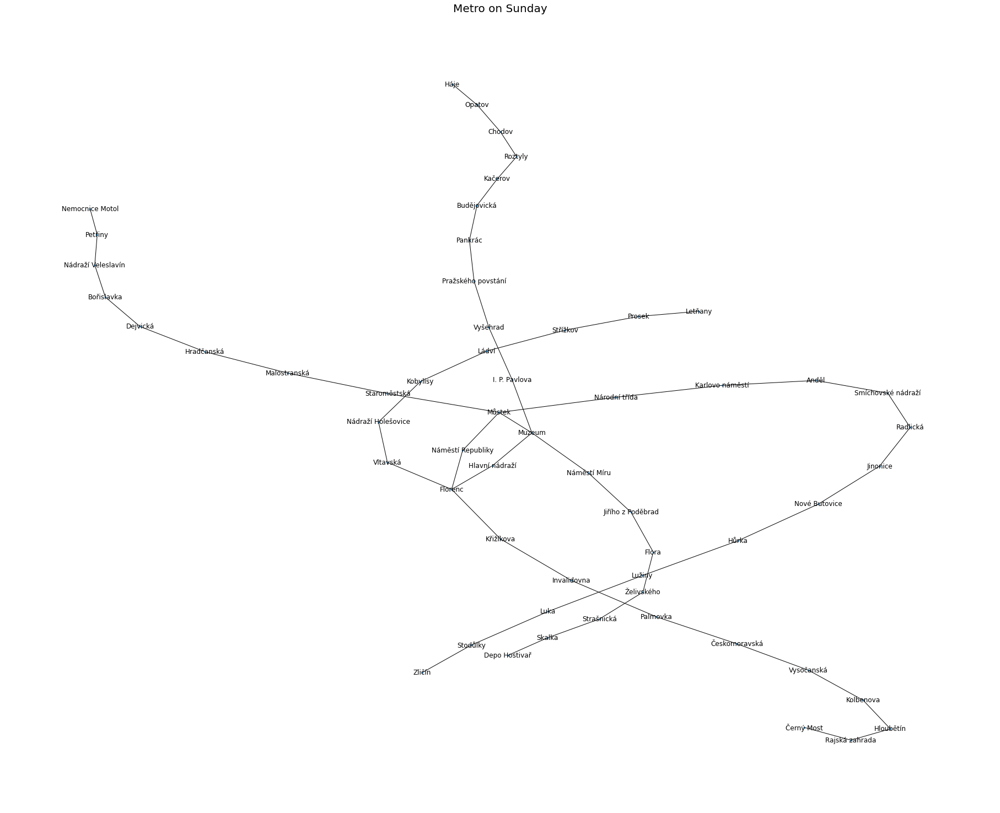

In [ ]:
for route_type in route_types:
    plt.figure(figsize = (25,20))
    nx.draw(graph_route_type_sunday[route_type], node_size = 5, with_labels = True)
    plt.title(f"{name_type[route_type]} on Sunday", fontsize = 20)
    plt.show()


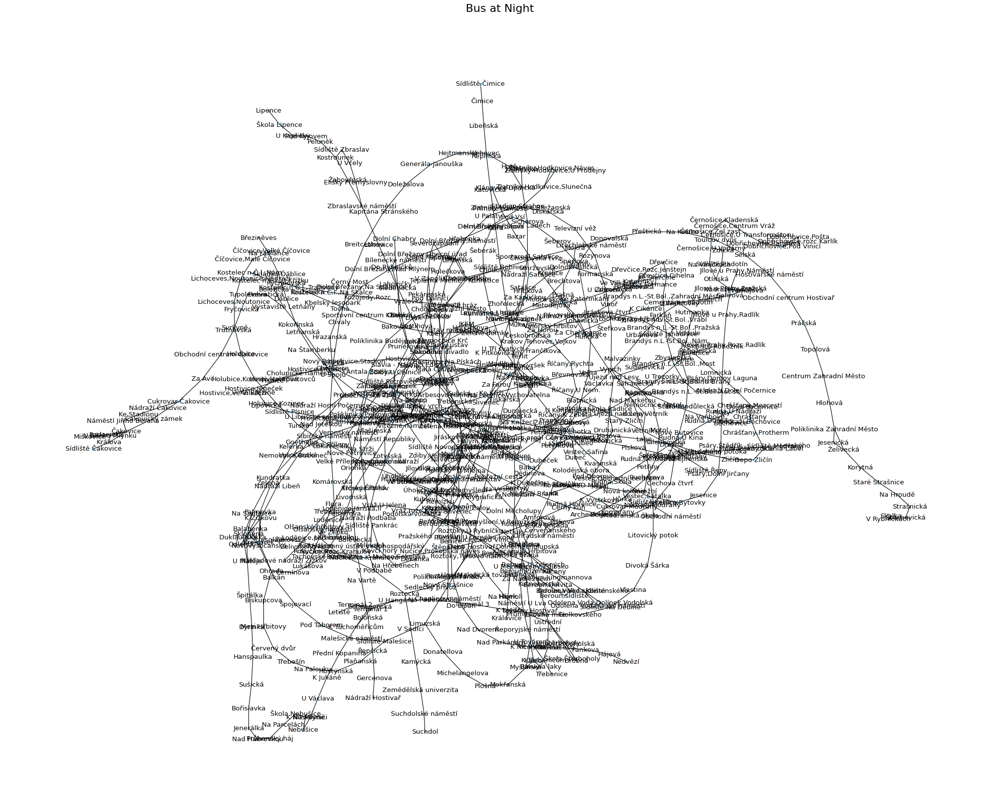

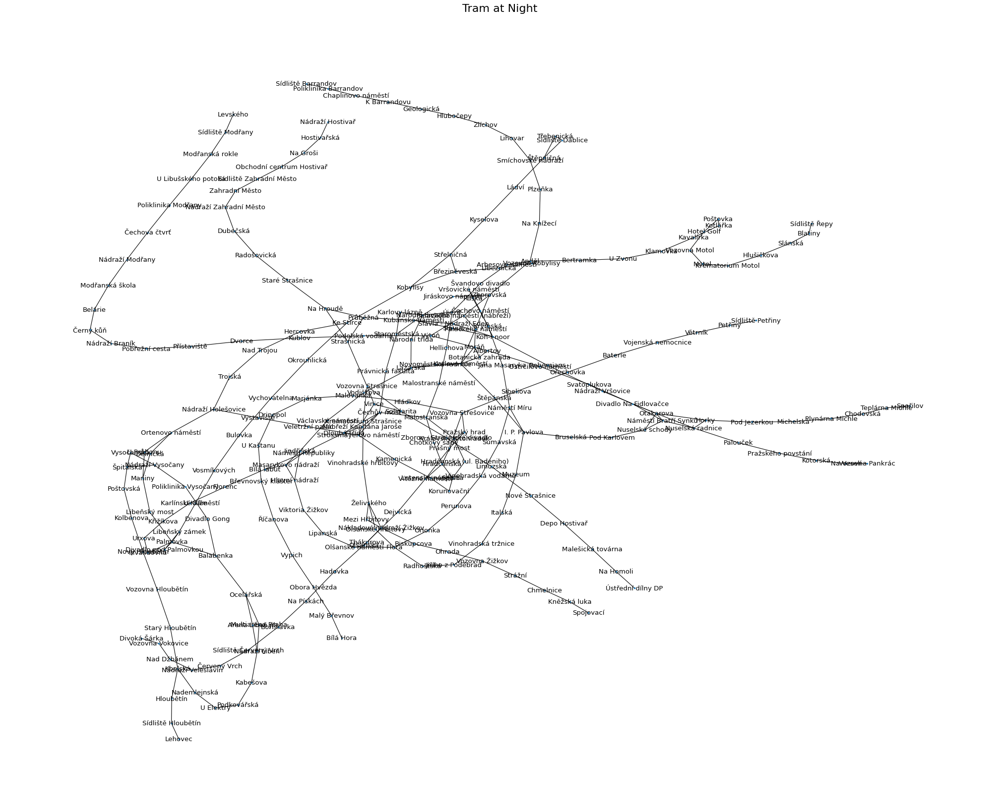

In [ ]:
for route_type in route_types:
    if nx.is_empty(graph_route_type_night[route_type]) == False:
        plt.figure(figsize = (25,20), dpi = 80)
        nx.draw(graph_route_type_night[route_type], node_size = 5, with_labels = True)
        plt.title(f"{name_type[route_type]} at Night", fontsize = 20)
        plt.show()

From theese graphs we can see, that the biggest amount of stations has `Bus` network. 

At night work only `Tram` and `Bus`

Of course, on Saturday and Sunday there are less loaded network of `Bus` and `Rail`. We will see better on the graphs in first question.

# Now let's look on metro network with length between stations. Length is counted in minutes between stations.

In [ ]:
metro_monday_graph = nx.Graph()
for idx, rows in df.iterrows():
    if rows.route_type == 1 and rows.monday == True:
        time = round(float(((rows["arrive_to"]-rows["depart_from"]).total_seconds())/60), 2)
        metro_monday_graph.add_edge(rows["stop_from_name"], rows["stop_to_name"], weight = time, length = time)

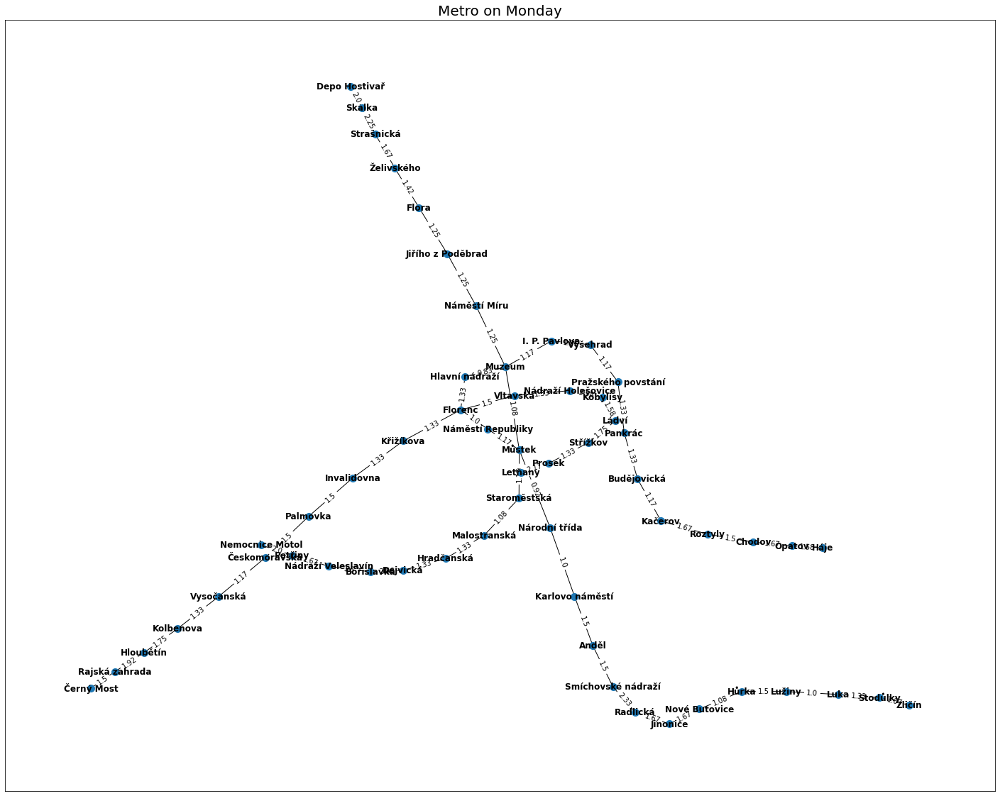

In [ ]:
plt.figure(figsize = (25,20))
#edge_labels = nx.get_edge_attributes(metro_monday_graph, "weight")
#nx.draw_spring(metro_monday_graph, with_labels=True, node_size = 6, edge_labels)

pos = nx.spring_layout(metro_monday_graph)
nx.draw_networkx(metro_monday_graph, pos, with_labels=True, font_weight = 'bold', node_size = 100)
labels = nx.get_edge_attributes(metro_monday_graph, 'weight')
nx.draw_networkx_edge_labels(metro_monday_graph, pos, edge_labels = labels)

plt.title(f"{name_type[1]} on Monday", fontsize = 20)
plt.show()

As we know, and we can see it on the graph, that the shortest path is between `Muzeum` and `Hlavni Nadrazi`. It takes 0.83 *minute* = 50 *seconds*

The longest path is between `Dejvicka` and `Borislavka`, `Nadrazi Holesovice` and `Kobylisy` and takes 2.58 *minutes* = 2 *minutes* 35 *seconds*

# **Let's analyse Tram network with centrality measures:**

*   *Degree_centrality*
*   *Eigenvctor_centrality*
*   *Closeness_centrality*



First of all, I create a function, which I'll use fir drawing centrality measures

I will analyse Tram network on Monday and Sunday. So I will draw graph for Monday and Sunday. 

Then, second graph will show us, how many stations exists with particular centrality score.

In [ ]:
import matplotlib.colors as mcolors
def draw(G, pos, measures, centrality_name): #this implementation of drawing centrality graphs was taken on https://aksakalli.github.io/2017/07/17/network-centrality-measures-and-their-visualization.html
    plt.figure(figsize = (25,25))
    nodes = nx.draw_networkx_nodes(G, pos, node_size = 250, cmap = plt.cm.plasma, node_color = list(measures.values()), nodelist = measures.keys())
    nodes.set_norm(mcolors.SymLogNorm(linthresh = 0.01, linscale = 1, base = 10))
    labels = nx.draw_networkx_labels(G, pos)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(centrality_name, fontsize = 16)
    plt.colorbar(nodes, shrink = 0.5)
    plt.show()

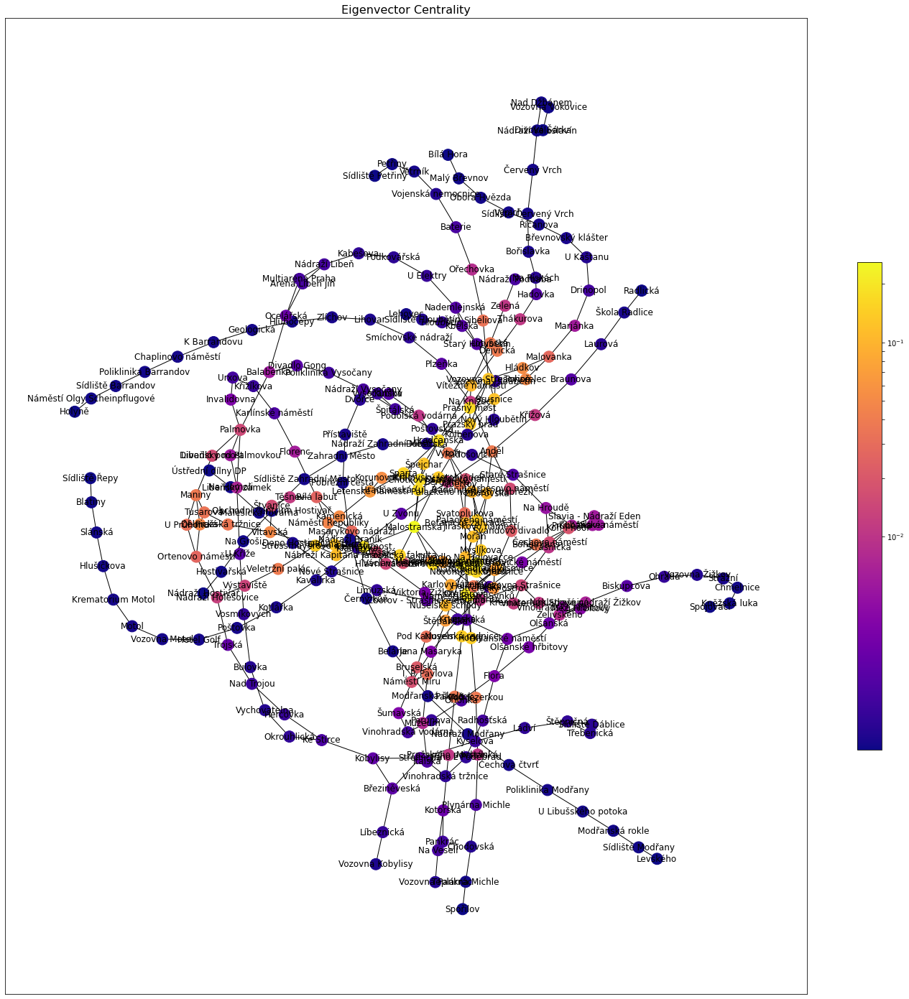

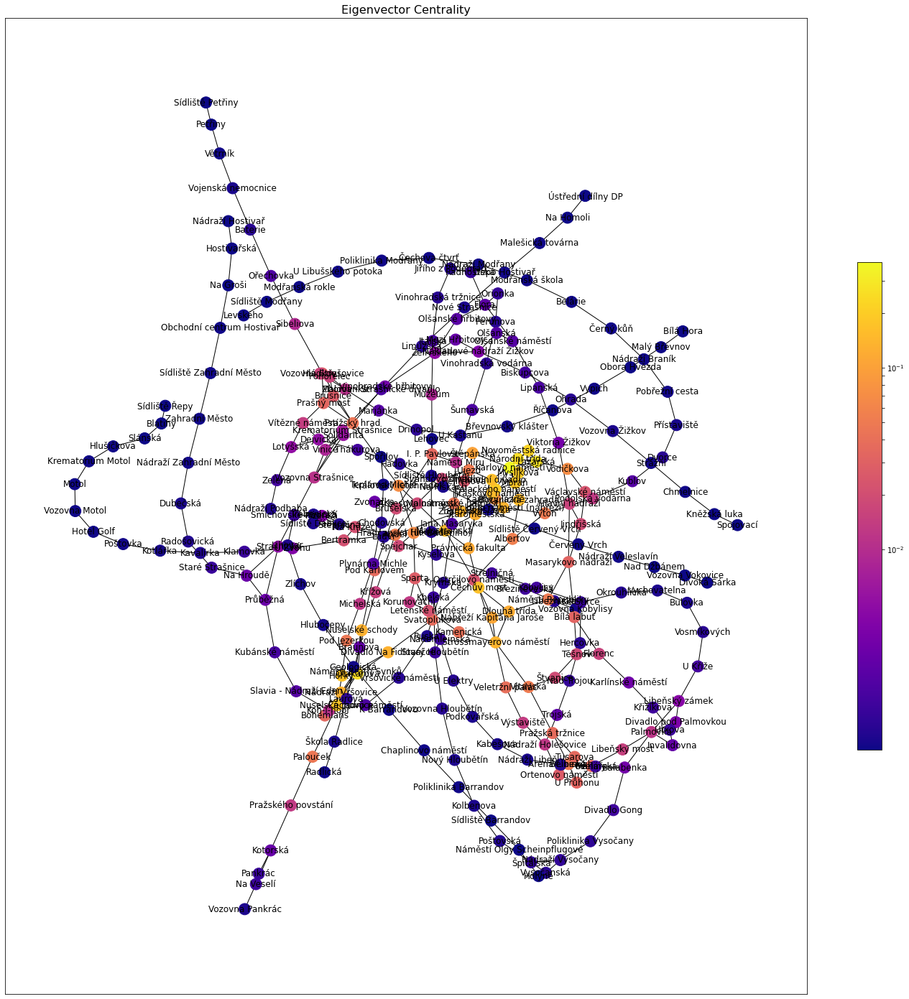

[('Malostranská', 0.2595396987359707), ('Karlovo náměstí', 0.24904455772842146), ('Národní třída', 0.22661755406033807), ('Lazarská', 0.20159600741670983), ('Náměstí Bratří Synků', 0.20007243921716125), ('Otakarova', 0.20007243921716125), ('Čechův most', 0.19514964560259815), ('Národní divadlo', 0.18075740723847072), ('Hradčanská', 0.1805187590071969), ('Chotkovy sady', 0.17698155276161995), ('Prašný most', 0.16711302185994703), ('Hradčanská (ul. Badeniho)', 0.1662253639594927), ('Staroměstská', 0.16470385234906296), ('Novoměstská radnice', 0.16458853474707644), ('Sparta', 0.15687174496680212), ('Právnická fakulta', 0.15123133837633515), ('Nuselská radnice', 0.1438211433678358), ('Horky', 0.1437316745502979), ('Strossmayerovo náměstí', 0.14306424426645795), ('Palackého náměstí', 0.1407043130465738), ('Královský letohrádek', 0.13773444974772292), ('Pražský hrad', 0.13747368958798672), ('Myslíkova', 0.13552511933708453), ('Vozovna Střešovice', 0.1279543521781575), ('Jiráskovo náměstí', 0

In [ ]:
nx.pagerank(graph_route_type_monday[0], max_iter=6000)
pos = nx.spring_layout(graph_route_type_monday[0])
draw(graph_route_type_monday[0], pos, nx.eigenvector_centrality(graph_route_type_monday[0], tol=1e-03), "Eigenvector Centrality")
pos = nx.spring_layout(graph_route_type_sunday[0])
draw(graph_route_type_sunday[0], pos, nx.eigenvector_centrality(graph_route_type_sunday[0], tol=1e-03), "Eigenvector Centrality")

monday =  nx.eigenvector_centrality(graph_route_type_monday[0], tol=1e-03)
sunday =  nx.eigenvector_centrality(graph_route_type_sunday[0], tol=1e-03)
print(sorted(monday.items(), key=lambda x: x[1], reverse = True))
print(sorted(sunday.items(), key=lambda x: x[1], reverse = True))

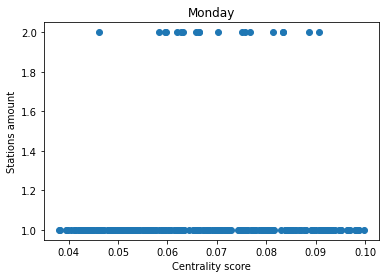

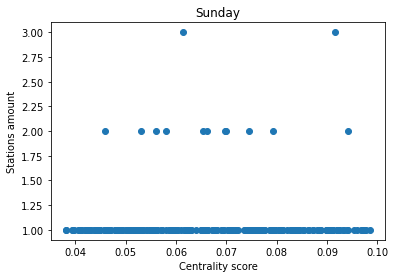

In [ ]:
centrality_amount_monday = {} # centrality_score: amount
keys_monday = set(monday.values())

for key in keys_monday:
    centrality_amount_monday[key] = 0
for value in monday.values():
    centrality_amount_monday[value] += 1

centrality_amount_sunday = {}
keys_sunday = set(sunday.values())
for key in keys_sunday:
    centrality_amount_sunday[key] = 0
for value in sunday.values():
    centrality_amount_sunday[value] += 1

plt.scatter(centrality_amount_monday.keys(), centrality_amount_monday.values())
plt.ylabel("Stations amount")
plt.xlabel("Centrality score")
plt.title("Monday")
plt.show()

plt.scatter(centrality_amount_sunday.keys(), centrality_amount_sunday.values())
plt.ylabel("Stations amount")
plt.xlabel("Centrality score")
plt.title("Sunday")
plt.show()


To be honest, `Eigenvector Centrality` network graph doesn't give us many info, that is why second graph in scatter form gives more info. On Sunday graph there are one station, which have a score `>0.375`. 

Monday graph has many station with low score `<0.025`

So stations on Sunday have more scores, that is why I can make a conclusion, that stations on Sunday are more "*prestige*"

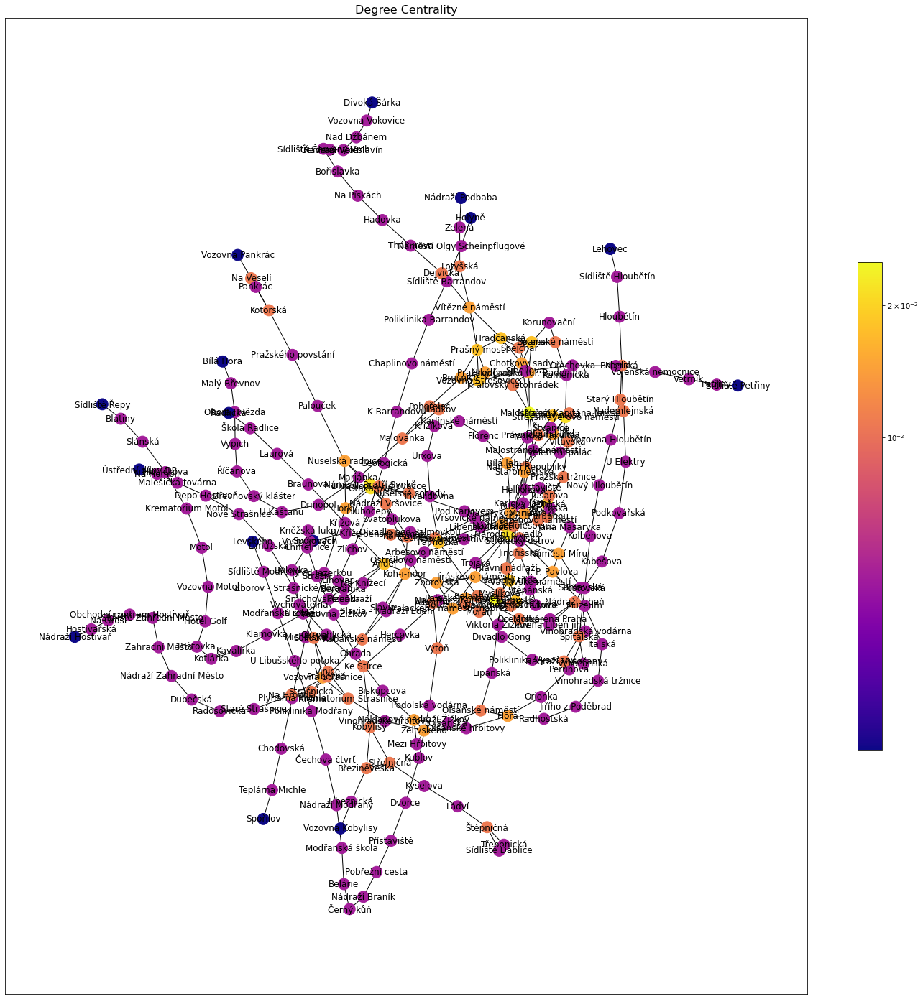

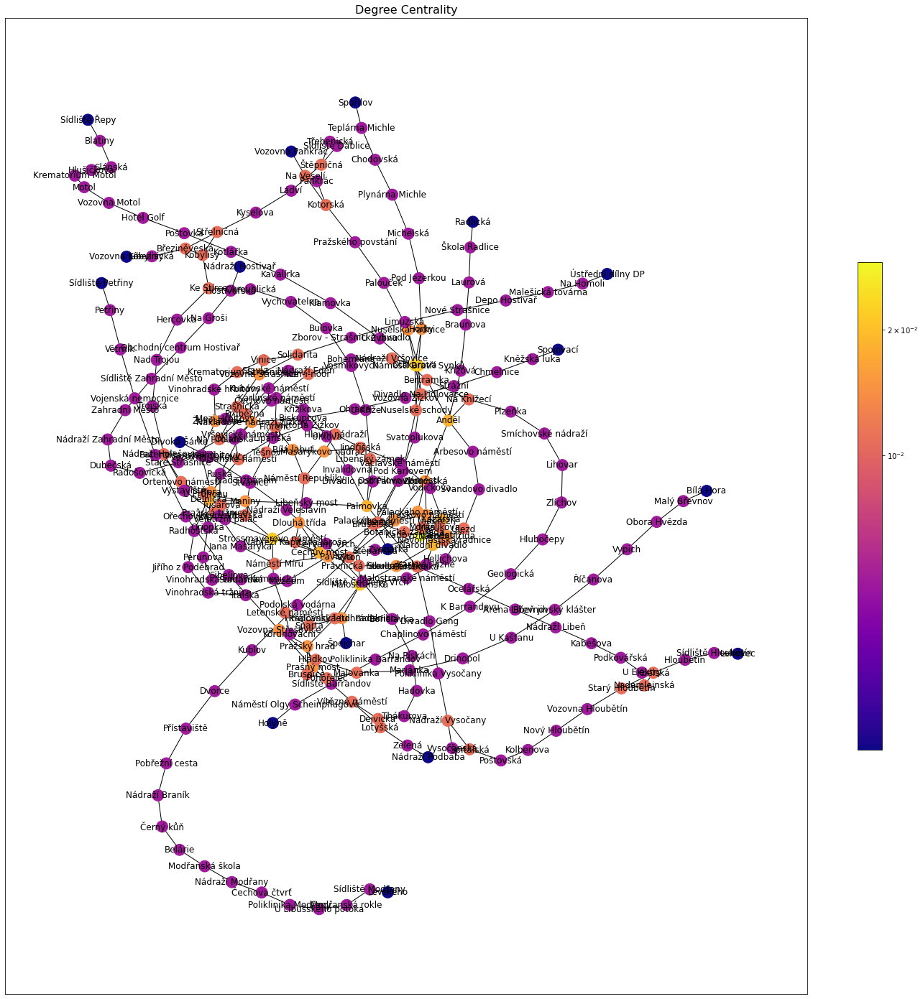

{'Karlovo náměstí': 0.025089605734767026, 'Malostranská': 0.025089605734767026, 'Náměstí Bratří Synků': 0.021505376344086023, 'Otakarova': 0.021505376344086023, 'Národní divadlo': 0.021505376344086023, 'Strossmayerovo náměstí': 0.021505376344086023, 'Anděl': 0.017921146953405017, 'Sparta': 0.017921146953405017, 'Dělnická': 0.017921146953405017, 'Hradčanská': 0.017921146953405017, 'Čechův most': 0.017921146953405017, 'Lazarská': 0.017921146953405017, 'Prašný most': 0.017921146953405017, 'Palmovka': 0.017921146953405017, 'Národní třída': 0.017921146953405017, 'Vozovna Střešovice': 0.017921146953405017, 'Zborovská': 0.014336917562724014, 'Palackého náměstí': 0.014336917562724014, 'I. P. Pavlova': 0.014336917562724014, 'Náměstí Míru': 0.014336917562724014, 'Flora': 0.014336917562724014, 'Želivského': 0.014336917562724014, 'Nákladové nádraží Žižkov': 0.014336917562724014, 'Nuselská radnice': 0.014336917562724014, 'Horky': 0.014336917562724014, 'Vozovna Strašnice': 0.014336917562724014, 'Koh

In [ ]:
nx.pagerank(graph_route_type_monday[0], max_iter=6000)
pos = nx.spring_layout(graph_route_type_monday[0])
draw(graph_route_type_monday[0], pos, nx.degree_centrality(graph_route_type_monday[0]), "Degree Centrality")
pos = nx.spring_layout(graph_route_type_sunday[0])
draw(graph_route_type_sunday[0], pos, nx.degree_centrality(graph_route_type_sunday[0]), "Degree Centrality")

monday =  nx.degree_centrality(graph_route_type_monday[0])
sunday =  nx.degree_centrality(graph_route_type_sunday[0])
monday = dict(sorted(monday.items(), key=lambda x: x[1], reverse = True))
sunday = dict(sorted(sunday.items(), key=lambda x: x[1], reverse = True))
print(monday)
print(sunday)

[0.0035842293906810036, 0.007168458781362007, 0.010752688172043012, 0.014336917562724014, 0.017921146953405017, 0.021505376344086023, 0.025089605734767026]
[0.0036363636363636364, 0.007272727272727273, 0.01090909090909091, 0.014545454545454545, 0.01818181818181818, 0.02181818181818182, 0.02909090909090909]


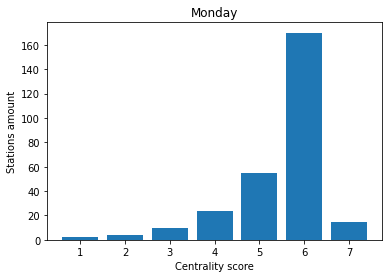

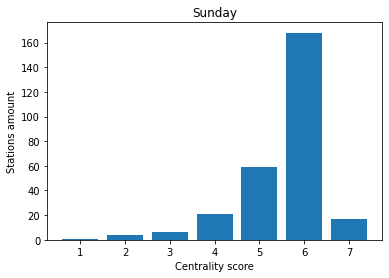

In [ ]:
centrality_amount_monday = {}
print(sorted(set(monday.values())))
for key in sorted(set(monday.values())):
    centrality_amount_monday[key] = 0
for value in monday.values():
    centrality_amount_monday[value] += 1

centrality_amount_sunday = {}


print(sorted(set(sunday.values())))
for key in sorted(set(sunday.values())):
    centrality_amount_sunday[key] = 0
for value in sunday.values():
    centrality_amount_sunday[value] += 1

count = 7
for key in sorted(set(sunday.values())):
    centrality_amount_sunday[count] = centrality_amount_sunday[key]
    del centrality_amount_sunday[key]
    count -= 1
count = 7
for key in sorted(set(monday.values())):
    centrality_amount_monday[count] = centrality_amount_monday[key]
    del centrality_amount_monday[key]
    count -= 1

plt.bar(centrality_amount_monday.keys(), centrality_amount_monday.values())
plt.ylabel("Stations amount")
plt.xlabel("Centrality score")
plt.title("Monday")
plt.show()

plt.bar(centrality_amount_sunday.keys(), centrality_amount_sunday.values())
plt.ylabel("Stations amount")
plt.xlabel("Centrality score")
plt.title("Sunday")
plt.show()


I found out, that `Degree Centrality` scores have only 7 unique values. So I used this fact in plotting second graph.

Seems that graphs are similar, but they're different. 

However, graphs should be similar.

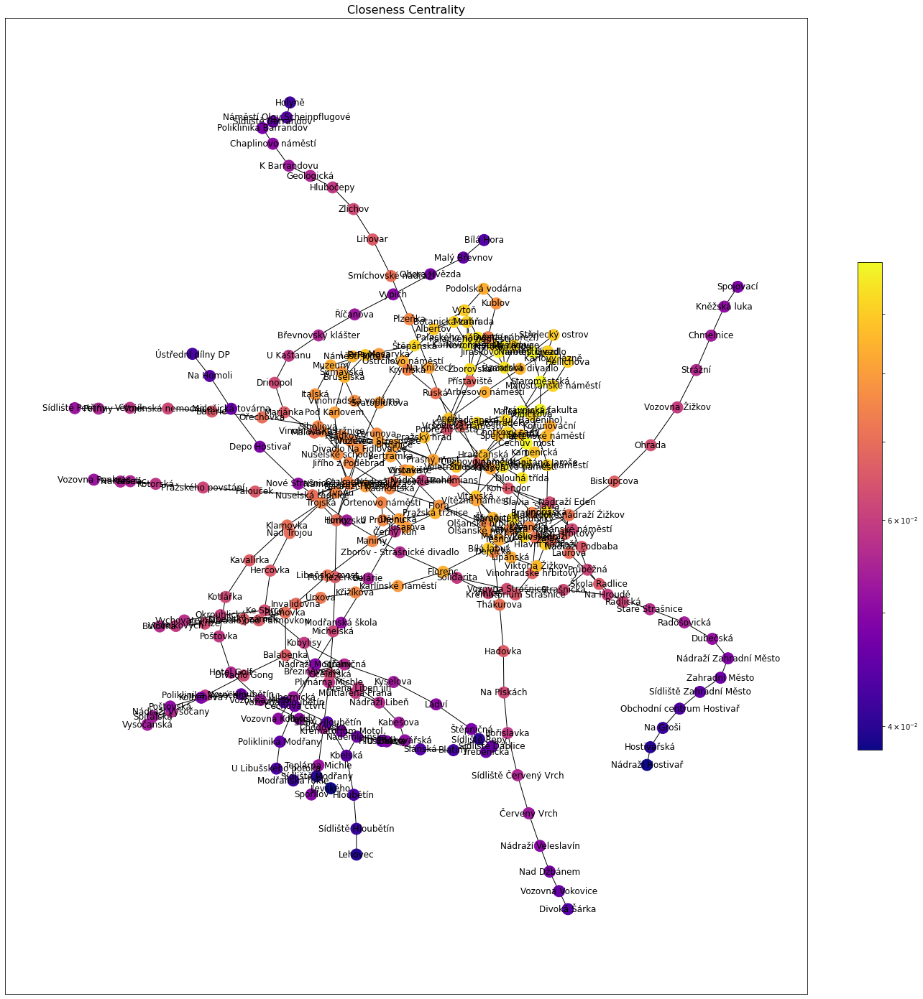

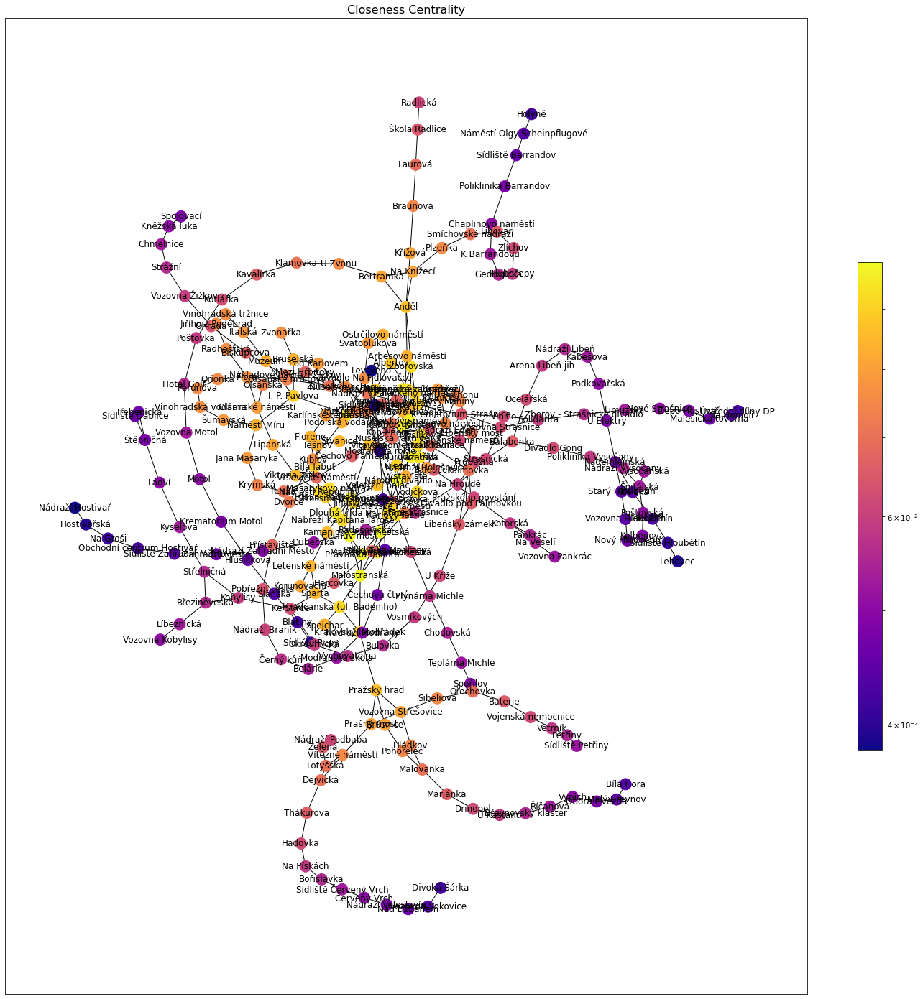

[('Malostranská', 0.09971408148677627), ('Národní divadlo', 0.09872611464968153), ('Staroměstská', 0.09844742413549754), ('Čechův most', 0.0982394366197183), ('Právnická fakulta', 0.09803232607167955), ('Jiráskovo náměstí', 0.09684137452273515), ('Karlovo náměstí', 0.09653979238754325), ('Národní třída', 0.09624008278716799), ('Strossmayerovo náměstí', 0.0950920245398773), ('Dlouhá třída', 0.09502724795640327), ('Palackého náměstí (nábřeží)', 0.09493024838380401), ('Lazarská', 0.09467254835425856), ('Zborovská', 0.09393939393939393), ('Karlovy lázně', 0.09353000335232987), ('Nábřeží Kapitána Jaroše', 0.09309309309309309), ('Masarykovo nádraží', 0.09284525790349418), ('Královský letohrádek', 0.09269102990033222), ('Chotkovy sady', 0.09262948207171315), ('Náměstí Republiky', 0.09253731343283582), ('Štěpánská', 0.09244532803180915), ('Novoměstská radnice', 0.0923841059602649), ('Jindřišská', 0.09235352532274081), ('Hradčanská (ul. Badeniho)', 0.09217046580773043), ('Myslíkova', 0.09214002

In [ ]:
nx.pagerank(graph_route_type_monday[0], max_iter=6000)
pos = nx.spring_layout(graph_route_type_monday[0])
draw(graph_route_type_monday[0], pos, nx.closeness_centrality(graph_route_type_monday[0]), "Closeness Centrality")
pos = nx.spring_layout(graph_route_type_sunday[0])
draw(graph_route_type_sunday[0], pos, nx.closeness_centrality(graph_route_type_sunday[0]), "Closeness Centrality")

monday =  nx.closeness_centrality(graph_route_type_monday[0])
sunday =  nx.closeness_centrality(graph_route_type_sunday[0])
print(sorted(monday.items(), key=lambda x: x[1], reverse = True))
print(sorted(sunday.items(), key=lambda x: x[1], reverse = True))

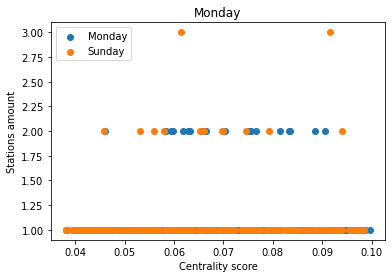

In [ ]:
centrality_amount_monday = {}
keys_monday = set(monday.values())

for key in keys_monday:
    centrality_amount_monday[key] = 0
for value in monday.values():
    centrality_amount_monday[value] += 1

centrality_amount_sunday = {}
keys_sunday = set(sunday.values())
for key in keys_sunday:
    centrality_amount_sunday[key] = 0
for value in sunday.values():
    centrality_amount_sunday[value] += 1

plt.scatter(centrality_amount_monday.keys(), centrality_amount_monday.values(), label = "Monday")
plt.scatter(centrality_amount_sunday.keys(), centrality_amount_sunday.values(), label = "Sunday")
plt.legend()
plt.ylabel("Stations amount")
plt.xlabel("Centrality score")
plt.title("Monday")
plt.show()




For better analyse I plotted it on one graph, where we can see, that 2 Sunday stations has same score and Monday graph has more stations, which are scored same twice.

## Question 1


> How many stops of does each transport make every day?




In [ ]:
weekdays = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
weekday_route_type_amount = {}


for day in weekdays:
    weekday_route_type_amount[day] = {}
    for route_type in route_types:
        if day == "Monday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.monday == True)].index)
        if day == "Tuesday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.tuesday == True)].index)
        if day == "Wednesday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.wednesday == True)].index)
        if day == "Thursday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.thursday == True)].index)
        if day == "Friday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.friday == True)].index)
        if day == "Saturday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.saturday == True)].index)
        if day == "Sunday":
            weekday_route_type_amount[day][route_type] = len(df.loc[(df.route_type == route_type) & (df.sunday == True)].index)

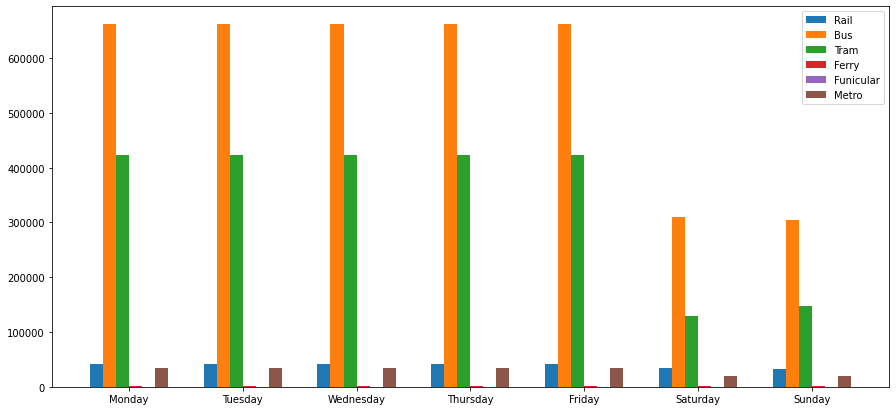

In [ ]:
import numpy as np

fig = plt.figure(figsize = (15, 7))
width = -2.8
for route_type in route_types:
    width += 0.8
    values = list()
    for day in weekdays:
        values.append(weekday_route_type_amount[day][route_type])
    x = np.arange(len(weekdays))*7
    plt.bar(x+width, values, label=f"{name_type[route_type]}")
    plt.legend()
    plt.xticks(x, weekdays)
plt.show()

In [ ]:
for route_type in route_types:
    for day in weekdays:
        print(f"{name_type[route_type]} on {day} has {weekday_route_type_amount[day][route_type]} stops")
    print("----------------------------------------------------------------")

Rail on Monday has 41964 stops
Rail on Tuesday has 41958 stops
Rail on Wednesday has 41958 stops
Rail on Thursday has 41958 stops
Rail on Friday has 42098 stops
Rail on Saturday has 33660 stops
Rail on Sunday has 33145 stops
----------------------------------------------------------------
Bus on Monday has 661265 stops
Bus on Tuesday has 661265 stops
Bus on Wednesday has 661265 stops
Bus on Thursday has 661265 stops
Bus on Friday has 661236 stops
Bus on Saturday has 309779 stops
Bus on Sunday has 303632 stops
----------------------------------------------------------------
Tram on Monday has 422257 stops
Tram on Tuesday has 422257 stops
Tram on Wednesday has 422257 stops
Tram on Thursday has 422257 stops
Tram on Friday has 422257 stops
Tram on Saturday has 128916 stops
Tram on Sunday has 146838 stops
----------------------------------------------------------------
Ferry on Monday has 684 stops
Ferry on Tuesday has 684 stops
Ferry on Wednesday has 684 stops
Ferry on Thursday has 684 sto

From this graph we can see, that `Bus` and `Tram` really depend on the day of the week. On Sunday and Saturday amount of stop is almost 2-times less than on working days.



## Question 2


> Try to count, how many lines do of each transport  exist








Here I will use fact, that `Degree_centrality` has only 7 unique values, so end stations will have the lowest score. And I want to count amount of stations with the lowest score.

In [ ]:
route_type_lines_working_days = {}
route_type_lines_night = {}

for route_type in route_types:
    route_type_lines_working_days[route_type] = 0
    centrality = nx.degree_centrality(graph_route_type_monday[route_type])
    min_amount = {}
    min = 1
    min_amount[min] = 0

    for key in centrality.keys():
        if centrality[key] == min:
            min_amount[min] += 1
        
        if centrality[key] < min:
            del min_amount[min]
            min = centrality[key]
            min_amount[min] = 1
       
    print(f"{name_type[route_type]} has {min_amount[min]/2} lines")

Rail has 12.5 lines
Bus has 118.0 lines
Tram has 7.5 lines
Ferry has 6.0 lines
Funicular has 1.0 lines
Metro has 3.0 lines


Output shows us, that it's impossible to count amount of lines. It is not difficult to understand the reason: some lines starts or stops at the same station. However, lines of metro is correct, cause in Prague the end stations are uniquely defined.

## Third question


> Show, how is possible to arrive at `Vaclavske Namesti` tram station from `Thakurova` tram station





11


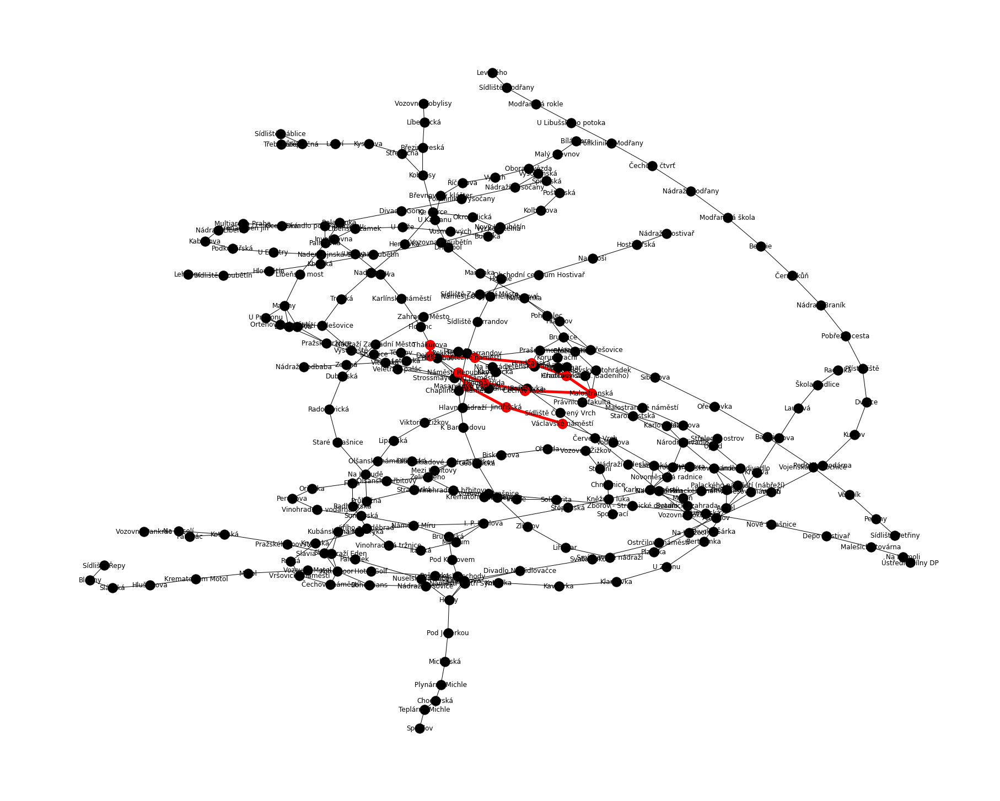

In [ ]:
figure = plt.figure(figsize = (25,20))
short_path = nx.shortest_path(graph_route_type_monday[0], source = "Thákurova", target = "Václavské náměstí")
print(nx.shortest_path_length(graph_route_type_monday[0], source = "Thákurova", target = "Václavské náměstí"))
pos = nx.spring_layout(graph_route_type_monday[0])
nx.draw(graph_route_type_monday[0],pos,node_color = 'k', with_labels = True)
edges = list(zip(short_path, short_path[1:]))
nx.draw_networkx_nodes(graph_route_type_monday[0], pos, nodelist = short_path, node_color = 'r')
nx.draw_networkx_edges(graph_route_type_monday[0], pos, edgelist = edges, edge_color = 'r',width=5)
plt.show()

11


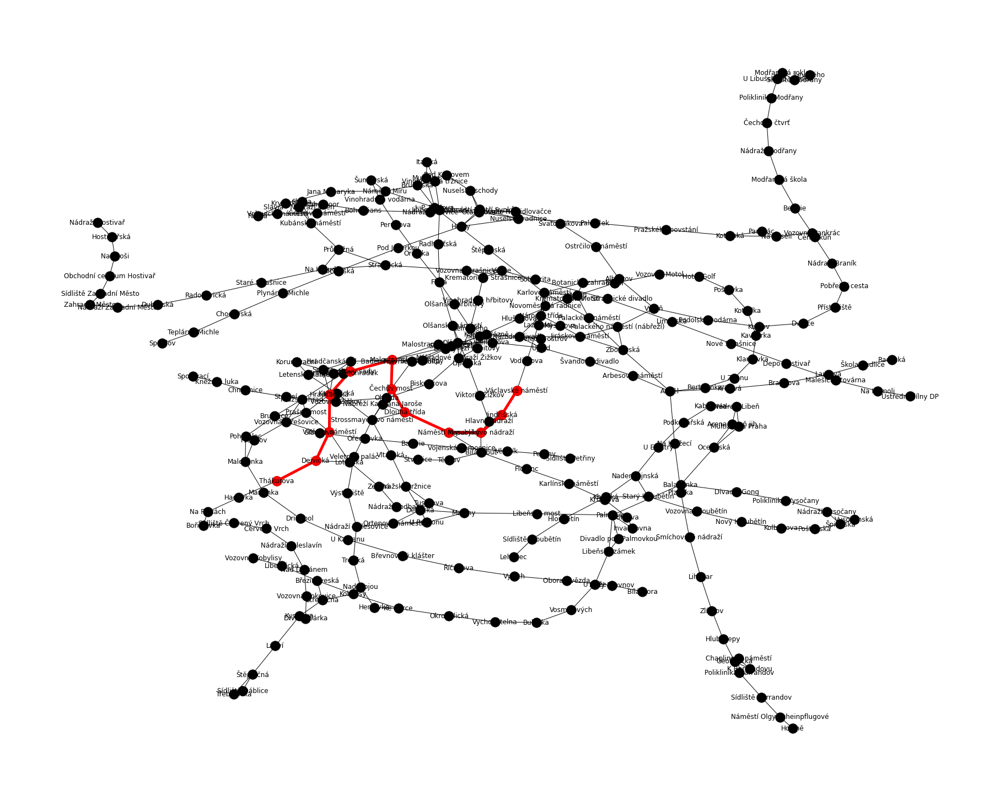

In [ ]:
figure = plt.figure(figsize = (25,20))
short_path = nx.dijkstra_path(graph_route_type_monday[0], source = "Thákurova", target = "Václavské náměstí")
print(nx.dijkstra_path_length(graph_route_type_monday[0], source = "Thákurova", target = "Václavské náměstí"))
pos = nx.spring_layout(graph_route_type_monday[0])
nx.draw(graph_route_type_monday[0], pos, node_color= 'k', with_labels = True)
edges = list(zip(short_path, short_path[1:]))
nx.draw_networkx_nodes(graph_route_type_monday[0], pos, nodelist = short_path, node_color = 'r')
nx.draw_networkx_edges(graph_route_type_monday[0], pos, edgelist = edges, edge_color = 'r', width = 5)

plt.show()

Here we used two alogrithms for the path: shortest_path(networkx) and dijkstra algorithm.